# Social Artists Explainer Notebook

In [1]:
# Miscellaneous packages used for various data-manipulation tasks
from tqdm.notebook import tqdm
import numpy as np
import pandas as pd
import os
from os import path
import pickle
import itertools
from datetime import datetime
import math
from scipy import stats
import calendar
from statistics import mode
import json
import random
from IPython.display import display

# For plotting
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objs as go

# API
import wikipedia as wi
from wikipedia import WikipediaPage as wp
import requests
from bs4 import BeautifulSoup

# Graph/Networks
import networkx as nx
import netwulf as nw
import community

# Text analysis
import nltk
import re
import wordcloud as wc
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import PorterStemmer

This notebook seeks to motivate the project as well as elaborate on data and methods used to make the final project in 02467 Computational Social Science. The accompanying website can be found [here](https://andreaslh.github.io/Social_Artists/).

Each group member contributed equally to the project, both in terms of coding and writing. Since we all coded simultaneously and on the same pieces of code it is impossible to make any clear distinction of who did what. 

## Table of contents

1. [Motivation](#motivation)  
    * [What data did we choose?](#what_dataset)  
    * [Why is this data interesting?](#why_dataset)  
    * [What is the end user's experience?](#enduser_dataset)  


2. [Basic stats](#basicstats)
    * [Obtaining data and pre-procssing](#data_processing)
        * [Get birth dates for rappers](#birthdates)
        * [Investigate if the rappers are dead or alive](#dead_alive)
        * [Find a secondary genre for each artist](#find_genres)
        * [Data used for graph/network analysis](#graph_data)
    * [Basic data statistics](#simpledata_stats)
    * [Distributions of birth dates](#dist_birthdates)
    * [Discussion of dataset stats](#discuss_dataset)


3. [Tools, theory and analysis](#methods)
    * [Network Analysis](#graph)
        * [Most popular hiphoppers](#pop_hip_hop)
        * [Distribution of in-degrees and out-degrees](#in_out_dist)
        * [Clustering coefficient](#cluster_coef)
        * [Small World](#small_world)
        * [Undirected graph analysis - Community detection](#un_graph_analysis)
        * [Louvain partitioning vs. group partitioning](#louv_vs_group)
        * [Assortativity](#assortativity)
        
    * [Text Analysis](#text)
         * [Lexical Diversity](#lexical_diversity)
         * [Sentiment Analysis](#sentiment_analysis)
         * [TF-IDF](#tf_idf)
             * [Sentiment based on the top 100 TF-IDF words from each person](#top_100_tf_idf)
         * [Age vs. Sentiment](#age_vs_sentiment)
         * [Wordclouds](#wordclouds)
             * [Looking at the top 5 highest and lowest artists wrt. sentiment score](#top5_wordclouds)
         * [Plotting wrt. louvain partitioning](#wordcloud_vs_louvain)
    
    
4. [Discussion](#discussion)
    * [What went well](#outcome)
    * [Future work](#future)

# Motivation
<a id='motivation'></a>

The world of music is filled with diverse people and genres. Each genre contains subcultures with its very own artists. Artists who speak together, perform together, and create art together. They are *social artists*. 

On this website, we wish to give you an insight into The Social Network of hip hop artists. We have narrowed our focus to the hip hop artists since they are often very social in their work, doing a lot of collaborations and having relations with each other. Hence we hypothesise that the strength of the tools in network science will be apparent.

Hip-Hop is a music genre loved by many due to how it reflects upon some of the struggles, thoughts and situations that numerous young people are experiencing.  

> "They say I was the Obamination of Obamas nation" - (Yeezy [Kanye West])
>
> "Even the Genius asks his questions" - Tupac, "Me against the world"


### What data did we choose?
<a id='why_dataset'></a>

The data for this project was acquired by extracting information from the Wikipedia pages of a list of [hip-hop musicians](https://en.wikipedia.org/wiki/List_of_hip_hop_musicians). We went through all the subpages from this overview page to extract artist information. Following this procedure, we gathered data from approximately 2600 hip-hoppers. Hereof these six attributes were queried from the first API call: 

- Title
- Content
- Date of birth
- Links (URL)
- Artist links
- Categories



### Why is this data interesting?
<a id='why_dataset'></a>

While most people know about the music and the lyrics, many people do not know much about the artists and their social relationships. However, the artists and their relationships are as equally fascinating as their lyrics and music, since they are the minds behind it. In this project, we analyse the musicians themselves using Wikipedia as a reference. Potentially, we could also reveal a bit of insight into the music industry and the societal development provided by the people of the Hip-hop genre.


Hip Hop artists are very social in their work. Often the authors on hip-hop tracks are listed with many featuring artists and many songs are written in collaboration between multiple musicians. It is therefore interesting to model the social network among the hip-hoppers. We can use the tools of network analysis to examine the social relationship between hip-hoppers in terms of raw numbers. Then we can answer questions like who are the most central people in hip-hop? Who has many co-authors on their songs, or who are the co-authors to many songs? 
Of equal interest is how the artists are described by the public via their Wikipedia pages. Even though the pages are inherently neutral by design, it is still relevant to study how the sentiment of some hip-hoppers relates. We can also get to know if there are certain words or topics that are more relevant for an artist than for the rest.

#### Characteristics of the data

The data is **always on**: Wikipedia pages are updated frequently and typically quickly after events in a given person's life.

It is **Non-reactive** to our study since no one knows that we are collecting the data. It is not complete; however, it is very close to it in some cases. It is simply impossible for every single bit of information about a person to be on Wikipedia. This data is partially **incomplete** as it does not contain all desired information since it is from Wikipedia, a free encyclopedia, where anyone can edit a Wikipedia page if they so wish. Wikipedia often provides the initial information for one's research; however, it does not contain a complete description. Therefore, more often than not, one needs to find additional information from other places, thereby deeming it incomplete. To some extent, the data is **algorithmically confounded** since some artists' pages have warning boxes about expanding the article or adding sources to it. This could introduce some bias in pages such that people will contribute more to short pages such that they meet a certain short limit.

The data can, in some cases, be **dirty**, though this is not the case for the high-profile pages which are "semi-protected" or even fully protected by Wikipedia's administrators. On the contrary, many of the pages on Wikipedia are not protected at all, so the caveats of Wikipedia apply there.


### End user's experience
<a id='enduser_dataset'></a>
The goal of this analysis is to provide insight into the technical details of the Hip-hoppers. We decided to do this project hoping that readers would gain insights into the social network of hip hop artists and learn how interconnected the creators of hip hop are.  

<a id='basicstats'></a>

# Basic stats

This section will investigate the properties and distributions of the chosen dataset. With a starting point in the data, it seeks to discuss different aspects of the data and why it is distributed as it is.

<a id='data_processing'></a>

### Obtaining data and pre-procssing

The data was obtained through a mixture of methods. Firstly, the main part of the dataset was scraped from a [list of hip hop musicians](https://en.wikipedia.org/wiki/List_of_hip_hop_musicians) as provided by Wikipedia. The Wikipedia page provides a table of various hip-hop artists, and to extract the information for each artist, we simply used a python package [wikipedia API](https://github.com/goldsmith/Wikipedia) that allowed us to contact Wikipedia's API.  

The following lines of code show how we initialise with getting all the names of the different hip-hop artists from the original list. 


In [2]:
# do this check so that we have the artists in case the 
# wikipedia api stops working.
if not os.path.exists('cache/artists_raw.pkl'): 
    genre = "List of hip hop musicians"
    artists_raw = set(wp(genre).links)
    with open('cache/artists_raw.pkl', 'wb') as f:
        pickle.dump(artists_raw, f)
else:
    with open('cache/artists_raw.pkl', 'rb') as f:
        artists_raw = pickle.load(f)
print(f"Number of hip-hop artist: {len(artists_raw)}")

Number of hip-hop artist: 2593


And we see that the Wikipedia page provides information for 2593 different hip-hop artists. It should be known that the list as of right now can contain links that are not connected to an artist but e.g. a record label company. After the pre-processing of data, it will be apparent that some links have been removed, and the number of artists will thus not equate to 2593.

We already know by eye that some of the scraped link names aren't artists. We save those as a set called _bad_.

In [3]:
bad = set(["Hip hop music", "List of hip hop groups", "hip hop", "Biography portal", "Lists portal", "Music portal", "Lists of musicians", "Rap Artists Highlights", "AllMusic", "Rovi Corporation", "Hip hop musicians", "TiVo Corporation", "Portal:Biography", "Wikipedia:Contents/Lists", "Portal:Music"])

In [4]:
artists = list(artists_raw - bad)
len(artists)

2588

Removing all names from bad in the original list of artists yields 5 less.

To use the list as saved earlier in _artists_raw_ we create a function called _artist_links_. The idea is that we now go through each artist in _artists_raw_ and we scrape the following information with the Wikipedia API:

1. **Title**: corresponding to the artist's name
2. **Categories**: all the wiki categories the artist belongs to, e.g. Jay-Z being in the category of _1969 births_ because he was born in 1969 etc.
3. **Links**: All links embedded in the hyperlinks on the artist's wiki page.
4. **Content**: The body text
5. **Genre**: being hip hop
6. **Artist Links**: using the function _artist_links_ we go through _Links_ and see if that link is in the set of _artists_raw_, then it is deemed as an artist link.

In [5]:
def artist_links(links):
    '''create the artist links from the full set of links on each wikipedia page'''
    return [i for i in links if i in list(df.Title.values)]

Throughout most of this notebook, we use a cache system with the `pickle` module to save and load data, such that the notebook can be run quicker the second and to avoid redoing a lot of computations. So there will be a lof of code blocks that look like the following.


In [6]:
# Scraping data from wikipedia:
# This code queries the wikipedia API and pulls down all the data
# This code takes several hours to run, since the API is queried in sequence, a possible improvement could be to parallelize it. Most of the waiting time is just HTTPS responses.
if not os.path.exists('cache/hiphop.pkl'):
    # Define attributes
    attributes = ["Title", "Categories", "Links", "Content", "Genre"]
    # Create dataframe
    df = pd.DataFrame(columns=attributes)
    # control which artists the API fails to retrieve
    fails = []
    # Go through for each artist and save it in the dataframe
    for artist in tqdm(artists):
        try:
            # parse the page
            page = wp(artist)
            df_t = pd.DataFrame.from_dict({"Title": page.title, "Categories": page.categories, 
                            "Links": page.links, "Content": page.content,
                            "Genre": "hip-hop"}, orient='index')
            df_t = df_t.transpose()
            df = pd.concat([df, df_t], ignore_index=True)
        except (wi.PageError, wi.DisambiguationError) as e:
            fails.append(artist)
            print(artist, e)
    
    # Define the artist_links
    df['artist_links'] = df['Links'].apply(artist_links)
    # Save it as a pickle file
    with open('cache/hiphop.pkl', 'wb') as f:
        pickle.dump(df, f)
else:
    with open('cache/hiphop.pkl', 'rb') as f:
        df = pickle.load(f)


#### Just to be safe!
During the API calls, we saw that it sometimes got values from _bad_, thus we decided to be sure that none of the values in the _bad_ set were downloaded by running through the data frame and deleting them again.

In [7]:
def rem_hip(artist_links):
    return list(set(artist_links).difference(list(bad)))

In [8]:
df = df[df["Title"].str.contains('|'.join(bad))==False]
df['artist_links'] = df['artist_links'].apply(rem_hip)

We then decided to drop any duplicates, and then reset the index in the data frame.

As we are interested in making a social network of hip hop artists, we now explore the data frame, i.e. we create a row such that each artist is connected to one other artist (through artist_links) per row. An artist can have more rows if their original artist_links list contains more than one artist.

In [9]:
df = df.drop_duplicates(subset=['Title'])
df = df.reset_index()
df.head()

,index,Title,Categories,Links,Content,Genre,artist_links
0,0,Ishmael Butler,"[1969 births, 20th-century African-American pe...","[Billboard (magazine), Billboard Hot 100, Blac...","Ishmael Reginald Butler (born July 3, 1969) is...",hip-hop,"[Lil Tracy, Coko]"
1,1,Zeus (musician),"[1986 births, All BLP articles lacking sources...","[Botswana, Charma Gal, Cibil Nyte, D.I.Y Enter...","Game Goabaone Bantsi (born 22 July 1986), bett...",hip-hop,"[JR (rapper), Hip Hop Pantsula]"
2,2,C-Note (rapper),"[1976 births, 20th-century African-American pe...","[3-2, ABN (hip hop duo), AllMusic, Big Hawk, B...","Courtney Smith (born December 5, 1974), known ...",hip-hop,"[3-2, Big Hawk, Trae tha Truth, Lil' Keke, Big..."
3,3,Lil Mariko,"[1997 births, 21st-century American rappers, 2...","[Asian Americans, Bondage suit, Dorian Electra...","Katherine Mariko Zhang (born March 1, 1996), k...",hip-hop,"[Rico Nasty, Dorian Electra]"
4,4,Terry G,"[1986 births, 21st-century Nigerian singers, A...","[2face Idibia, 9ice, Afro pop, Benue State, Ch...","Gabriel Oche Amanyi (born March 17,1986), popu...",hip-hop,[9ice]


<a id='birthdates'></a>

#### Getting birth dates for the rappers
In addition to the data as scraped from above, we also decided to investigate when each rapper was born. We did this by using a regular expression.

We know that the birthdate of each hip-hopper is written on each page as something of the form (born October 24, 1986). The birthday string can be found with the regular expression `born.{1,16}\d{4}`, this expression matches an expression containing the word “born” (born) followed by 1 to 16 characters of any type (.{1,16}), followed by a 4 digit number \d{4}. Therefore, this expression will also match if the date is e.g. (born 24th of October 1986) or shuffled around in another way, as long as the year is last.

In [10]:
def parse_date(day):
    """ The following will try to match every conveivable way to match a date """
        # the formatting is
        # %a	Weekday, short version
        # %A	Weekday, full version
        # %d	Day of month 01-31
        # %b	Month name, short version
        # %B	Month name, full version
        # %m	Month as a number 01-12
        # %y	Year, short version, without century
        # %Y	Year, full version
        # %H	Hour 00-23
        # %I	Hour 00-12
        # %p	AM/PM
        # %M	Minute 00-59
        # %S	Second 00-59
    try:
        date = datetime.strptime(day, "%B %d, %Y").date()
    except ValueError:
        try:
            date = datetime.strptime(day, "%d %B %Y").date()
        except ValueError:
            try:
                date = datetime.strptime(day, "%B %d,%Y").date()
            except ValueError:
                try:
                    date = datetime.strptime(day, "%Y").date()
                except ValueError:
                    try:
                        date = datetime.strptime(day, "%B %Y").date()
                    except ValueError:
                        try:
                            date = datetime.strptime(day, "%B, %d %Y").date()
                        except ValueError:
                            date = datetime.strptime(day, "%d %b %Y").date()
    return date

In [11]:
temp = [re.findall(r'born.{1,16}\d{4}', df.Content[i]) for i in range(len(df.Content))]

In [12]:
# get the date as a datetime object, if no date is on the page, the date is 'None'
born_list = []
for item in temp:
    if len(item) != 0:
        item = item[0]
        item_list = item.split()
        if len(item_list) >= 3:
            if 'th' in item_list[2]: #checks if the date is eg. july 10th
                day = item_list[1] + ' ' +  item_list[2][:-2] + ',' + ' ' + item_list[3]
            elif item_list[1] == 'On' or item_list[1] == 'on' or item_list[1] == 'in' or item_list[1] == ';': # check if the date is "born in/on ..."
                day = ' '.join(item_list[2:])
                if 'and' in day: # check if there are multiple birthdays (groups) (pick the first one)
                    day = item_list[2]
            elif item_list[1] == 'c.': # c.= circa
                day = item_list[2]
            elif item_list[1] == 'released' and item_list[2] == 'in': # apparently someone has an album released in the same year they were born?
                day = item_list[-1]
            elif item_list[2] == 'or': # sometimes the articles says born in eg. 1980 or 1981
                day = item_list[1]
            else:
                day = ' '.join(item_list[1:]) # else just grab the date

        elif item_list[1] == '(1985' or item_list[1] == '(1987' or item_list[1] == '(1990' or item_list[1] == '(1984': # some weird cases
            day = item_list[1][1:]
        elif item_list[1] == '1975/1976': # again one weird case
            day = '1975'
        else:
            day = ' '.join(item_list[1:]) # else just grab the date, if this point is reached, typically only the year is retrieved

        date = parse_date(day)

        born_list.append(date)
    else:
        born_list.append(None)

It should be stated that this method (regex) is flawed because not all the pages have the same formatting of the birthdates. For instance, some pages will only have a year, some will have (city, year), and there are many more edge cases where it’s written in a completely different way. Furthermore, some pages do not even have a birth date listed on them, so nothing can be extracted. From this method, the birthdate of 77% of the hip-hoppers is obtained.

<a id='dead_alive'></a>

#### Extracting dead/alive information

We looked further into some of the edge cases, as well as seeing if the artist in question is dead or alive.

Some pages not matched by the above regular expression can still be improved on by doing a second pass with another regular expression. Since some hip-hoppers are dead, they have a birth date string formatted as something like (June 16, 1971 – September 13, 1996). We can use this information to create another regular expression like so: `(?<=\()[^)]+(?=\))`. This expression will match anything in between 2 parentheses, excluding the parenthesis. After doing that, we can look for a hyphen in the string to ensure that the string is actually of the form as the example given. Again, this method is slightly flawed, since we cannot know for sure that the string is not something like (1996-1997) in a discussion about something else on the page, to mitigate this we only consider the first pair on parentheses on the page. In total, the birthdate of 83% of the hip-hoppers is thus retrieved. Another advantage of this method is that we will have an attribute on each person of whether or not they are alive. This can be used in the further analysis


In [13]:
temp2 = [None]*len(born_list)
dead_list = [False]*len(born_list)
for i in range(len(df.Content)):
    if born_list[i] == None:
        temp2[i] = re.findall(r'(?<=\()[^)]+(?=\))', df.Content[i])

In [14]:
t3 = [i[0] if i != None and len(i) != 0 else None for i in temp2]
temp3 = [i if i == None or '-' in i or '\u2013' in i else None for i in t3] # '\u2013' is a weird '-' (hyphen)

In [15]:
def first_index(string, search_chars):
    '''Finds the first index of a multiple given string, similar to string.find() but with the possibility of searching for multiple different characters'''

    finds = [string.find(c) for c in search_chars]
    finds = [x for x in finds if x >= 0]

    if finds:
        return min(finds)
    else:
        return -1

In [16]:
birthdays = []
for i in temp3:
    if i != None:
        birthdays.append(i[:first_index(i, ['-', '\u2013'])]) # can use a similar thing if we want the dead date
    else:
        birthdays.append(None)

birthdays_f = []
for i in birthdays:
    if i is not None:
        if re.search(r'\d{4}', i) is not None:
            birthdays_f.append(i)
        else:
            birthdays_f.append(None)
    else:
        birthdays_f.append(None)

        
for i, item in enumerate(birthdays_f):
    if item is not None:
        try:
            birthdays_f[i] = parse_date(item.strip())
        except ValueError:
            birthdays_f[i] = None
        dead_list[i] = True 

In [17]:
cross = list(zip(born_list, birthdays_f))
birthdays_e = [pair[1] if pair[0] is None else pair[0] for pair in cross]

In [18]:
df["birthdate"] = birthdays_e

In [19]:
def percentage(L, predicate):
    return (sum(1.0 for v in L if v==predicate) / len(L)) * 100
print(percentage(born_list, None))
print(percentage(birthdays_e, None))

21.45922746781116
17.284432305891535


Before doing this, we lacked about 21% of all birth dates, and after doing this we still lack the birth dates of 17% of the artists.

To investigate if an artist is dead or alive, we create a function to go through each artist's _Categories_ to stem each word and see if any of the words are equal to _death_, if so we deem that artist to be _dead_.

In [21]:
def look_for_death(cat):
    # stem all words
    ps = PorterStemmer()
    res = [ps.stem(item) for subitem in list(map(str.split, cat)) for item in subitem]
    matches = ['death']
    if any(x in matches for x in res):
        return True
    else:
        return False

In [22]:
df["is_dead"] = df.Categories.apply(look_for_death)

In [23]:
df.head(2)

,index,Title,Categories,Links,Content,Genre,artist_links,birthdate,is_dead
0,0,Ishmael Butler,"[1969 births, 20th-century African-American pe...","[Billboard (magazine), Billboard Hot 100, Blac...","Ishmael Reginald Butler (born July 3, 1969) is...",hip-hop,"[Lil Tracy, Coko]",1969-07-03,False
1,1,Zeus (musician),"[1986 births, All BLP articles lacking sources...","[Botswana, Charma Gal, Cibil Nyte, D.I.Y Enter...","Game Goabaone Bantsi (born 22 July 1986), bett...",hip-hop,"[JR (rapper), Hip Hop Pantsula]",1986-07-22,False


<a id='find_genres'></a>

#### Find genres
In addition to knowing that the artists belong to hip-hop, we also decided to scrape information about other genres connected to them. We were interested in finding their so-called secondary genre, and to do that we used another library called [requests](https://docs.python-requests.org/en/latest/).

To extract this information, _requests_ was used to get the infobox on the artists’ respective wiki-pages from which the _Genre_ then could be found. This genre that comes from the infobox will be referred to as a _sub-genre_.

In [24]:
if not os.path.exists('cache/all_infobox_links.pkl') and not os.path.exists('cache/infobox_fails_artists.pkl'): 
    all_info_links = []
    fails = []
    # subject = 'Drake (musician)'
    for artist in tqdm(list(df.Title.values)):
        try:
            # manual query to the wikipedia API
            url = 'https://en.wikipedia.org/w/api.php'
            params = {
                        'action':'parse',
                        'prop':'text',
                        'format':'json',
                        'page':artist,
                        'section':0,
                        'redirects':''
                    }
            data = requests.get(url, params=params).json()
            # parse the downloaded webpage to extact the desired information
            soup = BeautifulSoup(data['parse']['text']['*'],'html.parser')

            infobox = soup.find('table',{'class':'infobox'})
            a_tags = infobox.find_all('a', href=True)

            links = []
            for tag in a_tags:
                if not tag.text == '' and 'wiki' in tag['href']:
                    links.append({'anchor':tag.text, 'title':tag['title']})

            all_info_links.append(list(pd.DataFrame(links).title.values))
        except:
            all_info_links.append(['UNK'])
            fails.append(artist)
            print(f"Number of fails: {len(fails), artist}")
    
    with open('cache/all_infobox_links.pkl', 'wb') as f:
        pickle.dump(all_info_links, f)
    with open('cache/infobox_fails_artists.pkl', "wb") as f:
        pickle.dump(fails, f)
else:
    with open('cache/all_infobox_links.pkl', 'rb') as f:
        all_info_links = pickle.load(f)
    with open('cache/infobox_fails_artists.pkl', 'rb') as f:
        fails = pickle.load(f)    

In [25]:
df['infobox'] = all_info_links

To distinguish a _sub_genre_ from another piece of information about the artist, another dataset was scraped using VBA and manual copy-paste.

The genre data-set, used to distinguish between the output from the infobox, was made by copying all links from [List of music genres and styles](https://en.wikipedia.org/wiki/List_of_music_genres_and_styles) into excel in which a VBA script then was made to convert all hyper-links into working Wikipedia URLs. Loading the URLs into python together with what genre each URL belongs to, made it possible to use the Wikipedia API to get the Title name of the genre as referenced by Wikipedia. Having the information about what genre all sub-genres belong to, e.g. _Lofi Hip Hop_ belongs to _Hip hop_ and _Electronic_, made it possible to create a connection between the two, which in turn enabled us to take all the sub-genres within each artist's infobox and convert them into their respective main-genres. To decide which _sub_genre_ is the secondary genre then comes down to which _sub_genre_ that has the most occurrences, e.g. if an artist has 4 genres in their infobox;

[Electronic, Punk, Hip Hop, Electronic]

Taking the mode of the list of genres then provides the most frequent, and if they all occur an equal number of times it returns the first element of the list. It will never choose Hip hop, as it always will be its _main genre_. If the list is empty, then that artist gets _Pure hip hop_ as its _secondary genre_. In the example above the algorithm would simply return _Electronic_.

Extracting the genre names from each url

In [27]:
def get_name(link):
    # scraping a wikipedia article
    url_link = link
    request = requests.get(url_link)

    Soup = BeautifulSoup(request.text, 'lxml')

    # creating a list of all common heading tags
    return str(Soup.find("h1", {'class':'firstHeading'}).text.strip())

Creating the _music_genres_ dataset that contains all genres and their sub-genres

In [132]:
if not os.path.exists('cache/music_genres.pkl'):
    music_genres = pd.read_csv('music_genres.csv', sep=';')
    data = []
    
    for link in tqdm(music_genres.Link.values):
        data.append(get_name(link))
    
    music_genres['name'] = data
    
    with open('cache/music_genres.pkl', "wb") as f:
        pickle.dump(music_genres, f)
else:
    with open('cache/music_genres.pkl', "rb") as f:
        music_genres = pickle.load(f)
music_genres.head()

,Genre,Link,name
0,Art (classical),https://www.wikiwand.com/en/Andalusian_classic...,Andalusi classical music
1,Art (classical),https://www.wikiwand.com/en/Indian_classical_m...,Indian classical music
2,Art (classical),https://www.wikiwand.com/en/Korean_court_music,Korean court music
3,Art (classical),https://www.wikiwand.com/en/Persian_classical_...,Persian traditional music
4,Art (classical),https://www.wikiwand.com/en/Western_classical_...,Classical music


Defining the function that takes values from the infobox and processes them to only contain the genres.

In [29]:
def clean_info(info_list):
    data = [x for x in info_list if x in music_genres.name.values]
    if data:
        val = []
        for genre in data:
            val += list(music_genres.Genre[music_genres.name == genre].values)
        
        val = [ x for x in val if x !='Hip hop' ]
        if len(val) == 0:
            return 'Pure hip hop'
        else:
            return mode(val)
    else:
        return 'Pure hip hop'

Defining the secondary genre

In [30]:
df['secondary_genre'] = df.infobox.apply(clean_info)
df.head()

,index,Title,Categories,Links,Content,Genre,artist_links,birthdate,is_dead,infobox,secondary_genre
0,0,Ishmael Butler,"[1969 births, 20th-century African-American pe...","[Billboard (magazine), Billboard Hot 100, Blac...","Ishmael Reginald Butler (born July 3, 1969) is...",hip-hop,"[Lil Tracy, Coko]",1969-07-03,False,"[Seattle, Washington, Hip hop music, Blue Note...",Pure hip hop
1,1,Zeus (musician),"[1986 births, All BLP articles lacking sources...","[Botswana, Charma Gal, Cibil Nyte, D.I.Y Enter...","Game Goabaone Bantsi (born 22 July 1986), bett...",hip-hop,"[JR (rapper), Hip Hop Pantsula]",1986-07-22,False,"[TeachAids, Serowe, Hip hop music, Rapper, Hip...",Pure hip hop
2,2,C-Note (rapper),"[1976 births, 20th-century African-American pe...","[3-2, ABN (hip hop duo), AllMusic, Big Hawk, B...","Courtney Smith (born December 5, 1974), known ...",hip-hop,"[3-2, Big Hawk, Trae tha Truth, Lil' Keke, Big...",1974-12-05,False,"[Houston, Texas, U.S., Hip hop music, Rapper, ...",Pure hip hop
3,3,Lil Mariko,"[1997 births, 21st-century American rappers, 2...","[Asian Americans, Bondage suit, Dorian Electra...","Katherine Mariko Zhang (born March 1, 1996), k...",hip-hop,"[Rico Nasty, Dorian Electra]",1996-03-01,False,"[New York City, Hip hop music, Trap metal, Scr...",Punk
4,4,Terry G,"[1986 births, 21st-century Nigerian singers, A...","[2face Idibia, 9ice, Afro pop, Benue State, Ch...","Gabriel Oche Amanyi (born March 17,1986), popu...",hip-hop,[9ice],1986-03-17,False,"[Benue State, Afro pop, Keyboard instrument, G...",Pure hip hop


We now have the initial dataframe used for the graph and text analysis.

<a id='graph_data'></a>
#### Data used for graph/network analysis:
Important for the graph analysis is now to split the data wrt. the artist links such that each row only has one title and one artist link. This allows for easy visualisation and analysis of data.

In [31]:
df_ex = df.explode("artist_links").reset_index()
df_ex.head()

,level_0,index,Title,Categories,Links,Content,Genre,artist_links,birthdate,is_dead,infobox,secondary_genre
0,0,0,Ishmael Butler,"[1969 births, 20th-century African-American pe...","[Billboard (magazine), Billboard Hot 100, Blac...","Ishmael Reginald Butler (born July 3, 1969) is...",hip-hop,Lil Tracy,1969-07-03,False,"[Seattle, Washington, Hip hop music, Blue Note...",Pure hip hop
1,0,0,Ishmael Butler,"[1969 births, 20th-century African-American pe...","[Billboard (magazine), Billboard Hot 100, Blac...","Ishmael Reginald Butler (born July 3, 1969) is...",hip-hop,Coko,1969-07-03,False,"[Seattle, Washington, Hip hop music, Blue Note...",Pure hip hop
2,1,1,Zeus (musician),"[1986 births, All BLP articles lacking sources...","[Botswana, Charma Gal, Cibil Nyte, D.I.Y Enter...","Game Goabaone Bantsi (born 22 July 1986), bett...",hip-hop,JR (rapper),1986-07-22,False,"[TeachAids, Serowe, Hip hop music, Rapper, Hip...",Pure hip hop
3,1,1,Zeus (musician),"[1986 births, All BLP articles lacking sources...","[Botswana, Charma Gal, Cibil Nyte, D.I.Y Enter...","Game Goabaone Bantsi (born 22 July 1986), bett...",hip-hop,Hip Hop Pantsula,1986-07-22,False,"[TeachAids, Serowe, Hip hop music, Rapper, Hip...",Pure hip hop
4,2,2,C-Note (rapper),"[1976 births, 20th-century African-American pe...","[3-2, ABN (hip hop duo), AllMusic, Big Hawk, B...","Courtney Smith (born December 5, 1974), known ...",hip-hop,3-2,1974-12-05,False,"[Houston, Texas, U.S., Hip hop music, Rapper, ...",Pure hip hop


<a id='simpledata_stats'></a>
#### Simple data statistics of the dataframes

In [32]:
print(f"Unexploded dataset has {df.shape[0]} artists/rows and {df.shape[1]} attributes.")
print(f"Exploded dataset has {df_ex.shape[0]} rows and {df.shape[1]} attributes.")

Unexploded dataset has 2563 artists/rows and 11 attributes.
Exploded dataset has 34892 rows and 11 attributes.


It is evident that the original dataset used for text-analysis etc. has 2563 rows corresponding to 2563 hip-hop artists, and for each artist we have 11 attributes.

For the dataset used to create the directed and undirected graph of the hip-hop artists has 34892 rows, meaning we have multiple lines for each hip-hop artist. 

<a id='dist_birthdates'></a>
#### Distributions of birth dates

In [33]:
years = [1900 if item == None else item.year for item in list(df.birthdate.values)]

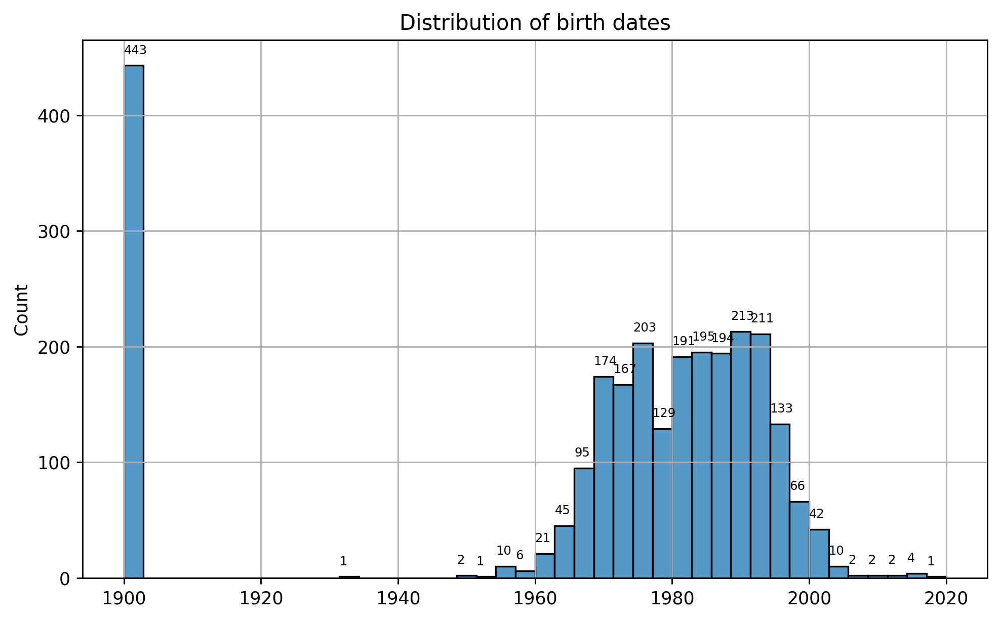

In [34]:
fig, ax = plt.subplots(figsize = (8,5), dpi=250)
plot = sns.histplot(years, kde=False)

for p in plot.patches:
    if p.get_height() != 0:
        ax.annotate('{:}'.format(p.get_height()), (p.get_x(), p.get_height()+10),  size=7)
ax.grid()
ax.set_title("Distribution of birth dates")
plt.tight_layout()
plt.savefig('plots/birthdate_distribution.png',dpi=300)
plt.show()

The figure above shows the distribution of the age of the hip-hoppers. The artists with age = None has been set to 1900 for visualisation purposes.

In the plot above we see that we are missing information from 443 different artists. The rest of the artists range from 1933 to 2020, with the majority being between 1970 and 2000.

<a id='discuss_dataset'></a>

### Discussion of dataset stats

First of all, there is an obvious limit to the way we get birth dates. The regular expression looks for the first match of "born ...", however, if the wiki page doesn't start with "born ..." when explaining who the artist is, then it will most probably mistakenly match with something else. Take for an instance _Thaiboy Digital_. His birth date has been mismatched with his daughter's birth date because the first time in which that sequence of letters is seen is in context with his daughter.

In [35]:
df[df.index == 405]

,index,Title,Categories,Links,Content,Genre,artist_links,birthdate,is_dead,infobox,secondary_genre
405,405,Thaiboy Digital,"[21st-century Swedish singers, 21st-century Th...","[Bangkok, Bladee, Cloud rap, Dandee, Dazed, Dr...",Thanapat Bunleang (born Khazitin G. Bonleunge)...,hip-hop,"[Bladee, Ecco2K, Gud (music producer), Yung Lean]",2020-02-09,False,"[Khon Kaen, Thailand, Stockholm, Sweden, Hip h...",Electronic


Preventing this would mean either switching up the regular expression or digging into the data and manually looking at the data errors. One way to do that is to look at a plot such as the one in the section about the [Distributions of birth dates](#dist_birthdates). Here it is evident that there are a few artists, allegedly, born in the 21-century, which seems improbable, though not impossible.

We can investigate how many entries/artists that are under 18 years old since these are people who probably have been parsed incorrectly by the regular expression:

In [36]:
print('#people under age 18:', len(df[df.birthdate >= datetime(2004, 1, 1).date()]))

#people under age 18: 16


<a id='methods'></a>

# Tools, theory and analysis

In this section we will elaborate on the different tools and methods used to perform out graph and text analysis.

<a id='graph'></a>

## Network Analysis

### Creating the graph representation

The graph is created by exploding the original dataframe based on the artist links attribute, and they grouped by the _Title_ and _artist_links_.

In [37]:
count = df_ex.groupby(['Title', 'artist_links']).count()
count

level_0  index  Categories  Links  Content  \
Title         artist_links                                                   
03 Greedo     Drakeo the Ruler        1      1           1      1        1   
              Kenny Beats             1      1           1      1        1   
              Key Glock               1      1           1      1        1   
              Lil Pump                1      1           1      1        1   
              Lil Uzi Vert            1      1           1      1        1   
...                                 ...    ...         ...    ...      ...   
Zuna (rapper) Loredana Zefi           1      1           1      1        1   
              Nimo (rapper)           1      1           1      1        1   
              RAF Camora              1      1           1      1        1   
Škabo         Gru (rapper)            1      1           1      1        1   
              Wikluh Sky              1      1           1      1        1   

                                Genre  birthdate  is_dead  infobox  \
Title         artist_links                                           
03 Greedo     Drakeo the Ruler      1          1        1        1   
              Kenny Beats           1          1        1        1   
              Key Glock             1          1        1        1   
              Lil Pump              1          1        1        1   
              Lil Uzi Vert          1          1        1        1   
...                               ...        ...      ...      ...   
Zuna (rapper) Loredana Zefi         1          1        1        1   
              Nimo (rapper)         1          1        1        1   
              RAF Camora            1          1        1        1   
Škabo         Gru (rapper)          1          1        1        1   
              Wikluh Sky            1          1        1        1   

                                secondary_genre  
Title         artist_links                       
03 Greedo     Drakeo the Ruler                1  
              Kenny Beats                     1  
              Key Glock                       1  
              Lil Pump                        1  
              Lil Uzi Vert                    1  
...                                         ...  
Zuna (rapper) Loredana Zefi                   1  
              Nimo (rapper)                   1  
              RAF Camora                      1  
Škabo         Gru (rapper)                    1  
              Wikluh Sky                      1  

[34773 rows x 10 columns]

Create the graph as a directed graph and the weights of the edges given by the number of links on each page

In [38]:
G = nx.DiGraph()
weighted_edges = [(a, pa, s) for (a, pa), s in zip(list(count.index), list(count.Links))]

In [39]:
second_genre = {df.Title.values[i]: df.secondary_genre.values[i] for i in range(len(df.Title.values))}

Investigate the distribution of the different subgenres

In [40]:
a = list(set(second_genre.values()))
b = [list(second_genre.values()).count(list(set(second_genre.values()))[i]) for i in range(len(a))]
df_temp = pd.DataFrame(b,a, columns=['count'])
df_temp.style.bar()

,count
Art (classical),2
Rock,73
Blues,154
Contemporary folk,2
Jazz,16
Metal,16
Avant-garde and experimental,1
Electronic,569
Pure hip hop,1497
Punk,6


As can be seen, by far the majority of the hip hop artists are pure hip-hoppers with the second-largest subgenre being electronic. Why is this the case? As mentioned earlier, an artist is categorised as _pure hip hop_ iff they have no other genre on their Wikipedia page.

For the further analysis, we will also create an undirected version of the graph

In [41]:
G.add_nodes_from(df_ex.Title)
G.add_nodes_from(df_ex.artist_links)
G.add_weighted_edges_from(weighted_edges)
G_un = G.to_undirected(reciprocal=True)
G_un.remove_edges_from(nx.selfloop_edges(G_un))
G_un.remove_nodes_from(list(nx.isolates(G_un)))
nx.set_node_attributes(G_un, second_genre, "group")

It should be mentioned that we in relation to creating the undirected graph also remove all isolates i.e. singletons and all self-loops. This is done to eliminate redundancy and remove nodes that provide little to no information about artist connections. One could argue that it would be interesting to look at the singletons if the case were to look at all connections, however, since connections between artists say more about how much they interact and feature in each others music, we have decided to remove all the isolates.

Let's take a look at some of the statistics of the network graph:

In [42]:
print(f"Nodes in the original graph: {len(G.nodes)}")
print(f"Edges in the original graph: {len(G.edges)}")
print(f"Nodes in the undirected graph: {len(G_un.nodes)}")
print(f"Edges in the undirected graph: {len(G_un.edges)}")
print(f"Fraction of the original network's nodes: {len(G_un.nodes)/len(G.nodes)}")
print(f"Fraction of the original network's edges: {len(G_un.edges)/len(G.edges)}")
print(f"The density of the network: {nx.density(G)}")

Nodes in the original graph: 2567
Edges in the original graph: 34773
Nodes in the undirected graph: 2094
Edges in the undirected graph: 7363
Fraction of the original network's nodes: 0.8157382158161278
Fraction of the original network's edges: 0.21174474448566416
The density of the network: 0.0052790969742772115


By transforming the network we preserve 82% of the nodes and 21% of the edges.
The density of the network (the total number of links over the maximum number of links) shows that the network is relatively sparse since it is relatively low.


Now we examine the  average, median, mode, minimum and maximum value of the in-degree (number of incoming edges per artist) And of the out-degree (number of outgoing edges per artist)

In [43]:
import numpy as np
from scipy import stats
in_degrees = list(dict(G.in_degree).values())
print("In-degree")
print(f"The average of in-degree: {np.mean(in_degrees)}")
print(f"The median of in-degree: {np.median(in_degrees)}")
print(f"The mode of in-degree: {stats.mode(in_degrees)[0][0]}")
print(f"The minimum of in-degree: {min(in_degrees)}")
print(f"The maximum of in-degree: {max(in_degrees)}\n")

out_degrees = list(dict(G.out_degree).values())
print("Out-degree")
print(f"The average of out-degree: {np.mean(out_degrees)}")
print(f"The median of out-degree: {np.median(out_degrees)}")
print(f"The mode of out-degree: {stats.mode(out_degrees)[0][0]}")
print(f"The minimum of out-degree: {min(out_degrees)}")
print(f"The maximum of out-degree: {max(out_degrees)}")

In-degree
The average of in-degree: 13.546162835995325
The median of in-degree: 5.0
The mode of in-degree: 1
The minimum of in-degree: 0
The maximum of in-degree: 315

Out-degree
The average of out-degree: 13.546162835995325
The median of out-degree: 9.0
The mode of out-degree: 4
The minimum of out-degree: 0
The maximum of out-degree: 149


The avg in- and out-degree degrees are the same since everything that points out must point into somewhere else.

For the in-degree we have a significantly smaller median and mode, indicating that there is a difference between how the artists refer to each other i.e. artists referring to a lot of other artists, but not that many artists referring to them.

<a id='pop_hip_hop'></a>
#### Who are the most popular hiphoppers?

We can examine this by considering the list of the top 10 hip-hoppers by in-degree and out-degree. 

In [44]:
N=10
in_degrees = dict(G.in_degree)
out_degrees = dict(G.out_degree)
max_in_deg = sorted(in_degrees, key=in_degrees.get, reverse=True)[:N]
max_out_deg = sorted(out_degrees, key=out_degrees.get, reverse=True)[:N]

In [45]:
a = pd.DataFrame(sorted(in_degrees.values(), reverse=True)[:N],max_in_deg,columns=['in-degree'])
a.style.bar(height=95)

,in-degree
Jay-Z,315
Lil Wayne,306
Kanye West,303
Eminem,300
Snoop Dogg,281
50 Cent,240
Nas,216
Busta Rhymes,214
Drake (musician),213
Kendrick Lamar,188


The table shows the top 10 artists by their in degree, i.e. how many other sites that refer to them. As expected the top artist are some very well known and popular artists.

In [46]:
a = pd.DataFrame(sorted(out_degrees.values(), reverse=True)[:N],max_out_deg,columns=['out-degree'])
a.style.bar(height=95)

,out-degree
Eminem,149
Kanye West,134
Kendrick Lamar,122
Drake (musician),118
Jay-Z,116
T.I.,116
Chris Brown,103
Missy Elliott,100
Lil Wayne,96
50 Cent,96


The table shows the top 10 artists by their out-degree, i.e. how many other sites they refer to on their own Wikipedia page. As expected the top artist in relation to out-degree also shows some very well known and popular artists. One reason for this is not only because more famous artists are prone to feature in other artists' songs, but the more famous an artist is the more probably it is that their Wikipedia page will be more comprehensive.

(Please note that some popular artists might have an unusually high out degree, simply because they are popular and thus have longer articles, this is not something we have investigated further)

<a id='in_out_dist'></a>
#### Distribution of in-degrees and out-degrees

We will now look at how many connections, or links in network terminology, each artist has. This is done by looking at each artist's node in-degrees, and out-degrees, where in-degrees are how many artists' wiki pages refer to their wiki page, and their out-degrees are how many artists their wiki refer to. The distribution of the in- and out-degrees for all artists is shown in the figure below. 


In [47]:
in_deg = dict(G.in_degree(G.nodes))
out_deg = dict(G.out_degree(G.nodes))

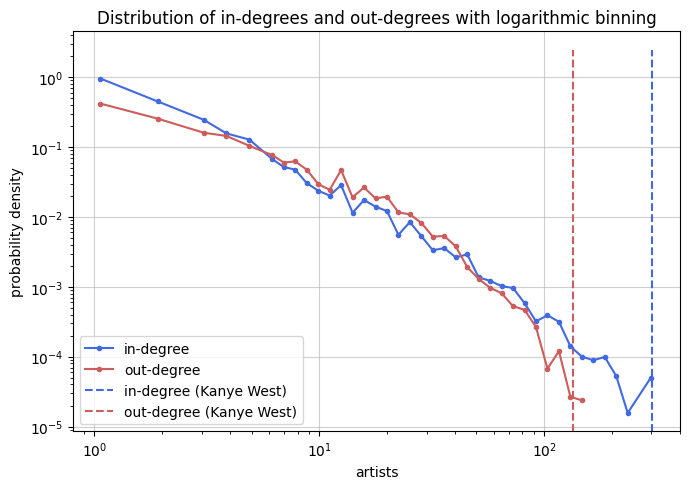

In [48]:
bins = np.logspace(0, np.log10(max(list(in_deg.values()))),50)
density = True
hist, edges = np.histogram(list(in_deg.values()), bins = bins, density = density)
x = (edges[1:] + edges[:-1])/2

xx, yy = zip(*[(i, j) for (i,j) in zip(x, hist) if j>0])

fig, ax = plt.subplots(dpi=300, figsize=(7,5))
#ax.bar(x, hist, width=width*0.9)
ax.plot(xx, yy, marker='.', color='royalblue',label='in-degree')
hist, edges = np.histogram(list(out_deg.values()), bins = bins, density = density)
x = (edges[1:] + edges[:-1])/2

xx, yy = zip(*[(i, j) for (i,j) in zip(x, hist) if j>0])
#ax.bar(x, hist, width=width*0.9)
ax.plot(xx, yy, marker='.', color='indianred', label='out-degree')

ax.set_xlabel('artists')
if density:
    ax.set_ylabel('probability density')
else:
    ax.set_ylabel('counts')
ax.set_yscale("log")
ax.set_xscale("log")
ax.set_title("Distribution of in-degrees and out-degrees with logarithmic binning")
ax.vlines(in_deg["Kanye West"], 0, np.log10(max(list(in_deg.values()))), ls="--", colors='royalblue', label='in-degree (Kanye West)')
ax.vlines(out_deg["Kanye West"], 0, np.log10(max(list(in_deg.values()))), ls="--", colors='indianred', label='out-degree (Kanye West)')
# ax.vlines(median, 0, np.log10(45_000),colors='g',label='median # comments')
ax.legend(loc='lower left')
plt.tight_layout()
plt.grid(alpha = .6)
plt.savefig('plots/in_out_deg_distribution.png', dpi=300)
plt.show()

The figure shows the distribution of the in- and out-degrees respectively. The mean is 13.54. The figure shows that the number of degrees for the artists rapidly decreases and that just 10% of the artists have five or more direct links to other artists. Kanye West is highlighted as an exciting person since he has the most in-degrees of all the artists, meaning that he is the one being referred to the most. Note that the distribution is roughly linear in the log-log scale, which means that the relationship follows a power law. 

##### In degree vs. out degree

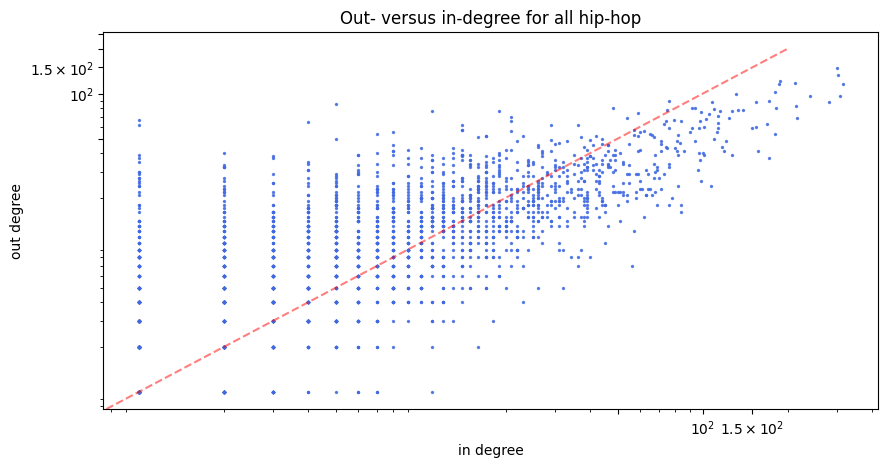

In [49]:
fig, ax = plt.subplots(figsize=(10,5) ,dpi=100)
ax.scatter(list(in_deg.values()), list(out_deg.values()), alpha=0.8,s=2, c="royalblue")
ax.set_yscale("log")
ax.set_xscale("log")
plt.xticks(np.arange(min(list(out_deg.values())), 200, 50))
plt.yticks(np.arange(min(list(in_deg.values())), 400, 50))
ax.plot([0, 10, 50, 100, 150, 175, 200], [0, 10, 50, 100, 150, 175, 200], "r--", alpha=0.5)
ax.set_xlabel('in degree')
ax.set_ylabel('out degree')

# plt.grid(alpha=0.5)
ax.set_title('Out- versus in-degree for all hip-hop');

plt.savefig('plots/in_out_scatter.png', dpi=300)

(This graph is produced in an improved version with the plotly library below and commented there)

In [50]:
# just some data cleaning for plotly
bad = set(list(out_deg.keys())).difference(set(df.Title))
for bad in bad:
    del out_deg[bad]
    del in_deg[bad]
df_scat = pd.DataFrame(np.array(df.Title),columns=['Title'])
df_scat['out_deg'] = out_deg.values()
df_scat['in_deg'] = in_deg.values()

In [51]:
fig1 = px.scatter(df_scat, x = 'in_deg', y = 'out_deg', hover_data=['Title'], log_x=True, log_y=True)
fig2 = px.line(x=[0, 10, 50, 100, 150, 175, 200],y=[0, 10, 50, 100, 150, 175, 200])
fig2.update_traces(line_color='red', opacity=0.5)

fig = go.Figure(data=fig1.data + fig2.data)
fig.update_layout(
    title="Out- versus in- degree for all Hip-hoppers",
    xaxis_title="In degree",
    yaxis_title="Out degree",
)


fig.update_layout(
    updatemenus=[
        dict(
            type = "buttons",
            direction = "left",
            buttons=list([
                dict(label='Linear Scale',
                    method='update',
                    args=[{'visible': [True, True]},
                       {'yaxis': {'type': 'linear','title':'Out degree'},
                        'xaxis': {'type': 'linear','title':'In degree'}}]),
                dict(label='Log Scale',
                 method='update',
                 args=[{'visible': [True, True]},
                       {'yaxis': {'type': 'log','title':'Out degree'},
                        'xaxis': {'type': 'log','range':[-0.1,2.3],'title':'In degree'}}])
            ]),
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.55,
            xanchor="left",
            y=1.3,
            yanchor="top"
        ),
    ]
)

# Add annotation
# fig.update_layout(
#     annotations=[
#         dict(text="Axis scaling:", showarrow=False,
#                              x=0, y=1.12, yref="paper", align="left")               
#     ]
# )
fig.write_json("plots/in_out_scatter_plotly.json")
fig.show()

The figure above shows the out-degree on the y-axis and the in-degree on the x-axis. The figure is interactive so you can hover over the points to see the musician. Use the button on the top right to change between linear and logarithmic axes. The red line indicates an even number of in and out-degree. We observe that many of the artists lie below the line which makes sense given the previous stats observed. The logarithmic plot does a much better job at showing the points.

<a id='cluster_coef'></a>
### Clustering coefficient

We can use clustering analysis to determine if the hip-hoppers form local groups in the network with a higher density than expected. We would probably expect subgroups of the hip-hoppers to work together with the same but slightly different subgroups, i.e. if they work with a friend of a friend, etc. In this fashion, clusters arise in the graph.
The Local clustering coefficient is defined for each node as
$$C_i = \frac{2L_i}{k_i(k_i-1)}$$
Where $k_i$ is the number of neighbours (degree) and $L_i$ is the number of edges in relation to node $i$’s neighbours.
Taking the mean over this gives us the average clustering coefficient
$$\langle C \rangle= \frac{1}{N}\sum_{i=1}^{N}C_i$$


In [52]:
def clustering_coef(graph: nx.Graph) -> dict:
    """Does the same as nx.algorithms.clustering"""
    clu_coef = {}
    for n in graph.nodes():
        neighbours = list(graph.neighbors(n))
        k = len(neighbours)
        L = len(graph.subgraph(neighbours).edges())
        clu_coef[n] = 2*L/(k*(k-1)) if k > 1 else 0
    return clu_coef

In [53]:
clus_coef = clustering_coef(G_un)
avg_clustering_coef = np.mean(list(clus_coef.values()))

To compare if clusters are present, we compare it to its random graph counterpart as a null model. The random graph is created with the same number of nodes and edges as the original graph. Connections between the nodes are created with probability $p$ such that the number of edges is the same as the original graph. 
$$p=\frac{2L}{N(N-1)}$$
where L and N are the number of edges and nodes, respectively.


In [54]:
# create random graph
# We make as many nodes in the random graph as there are in the reddit graph.
N = len(G_un.nodes)
L = len(G_un.edges)
p = L*2/(N*(N-1))
k = p*(N-1)
nodes = range(N)

# Then we make all combinations between all the nodes, and we include the link 
# if the random uniformly generated value for is less than probability p as computed above.
links = [link for link in itertools.combinations(nodes, 2) if np.random.rand() < p] 
# Now we create the graph
Grand = nx.Graph()
# Add the nodes and edges
Grand.add_nodes_from(nodes)
Grand.add_edges_from(links)
# remove any self-loops and nodes with zero-degree in and out.
Grand.remove_edges_from(nx.selfloop_edges(Grand)) # remove self-loops
Grand.remove_nodes_from(list(nx.isolates(Grand))) # remove nodes with zero-degree in and out
clus_coef_r = clustering_coef(Grand)
avg_clustering_coef_r = np.mean(list(clus_coef_r.values()))
print('avg_clustering_coef for random network:', avg_clustering_coef_r)
print('avg_clustering_coef for hip hoppers:', avg_clustering_coef)

avg_clustering_coef for random network: 0.003790075876301671
avg_clustering_coef for hip hoppers: 0.23127265912656048


This is a significantly higher (approx 100x higher) average clustering coefficient compared to a random network, this shows that the clustering in the hip hop network is present, additionally, the clustering coefficient is quite high (max is 1). 

Since the clustering coefficient for the hip-hop network is approximately larger than the coefficient for the random network, we conclude that clusters are indeed present.

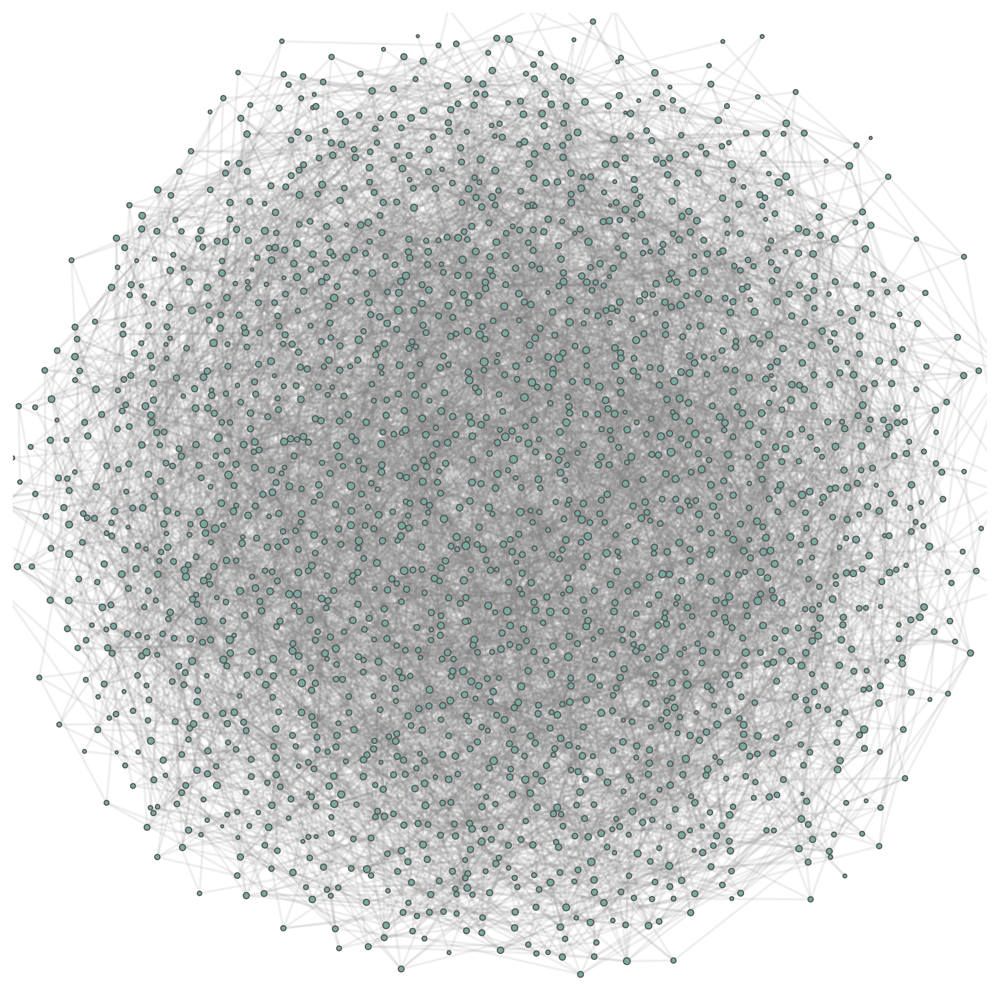

In [55]:
if not os.path.exists('plots/network_random.json'):
    network, config = nw.visualize(Grand, plot_in_cell_below=False)
    with open('plots/network_random.json', 'w') as f:
        json.dump(network, f)
    with open('plots/network_random_config.json', 'w') as f:
        json.dump(config, f)
else:
    with open('plots/network_random.json', 'r') as f:
        network = json.load(f)
    with open('plots/network_random_config.json', 'r') as f:
        config = json.load(f)

fig, ax = plt.subplots(figsize=(10,10),dpi=300)
nw.draw_netwulf(network, fig=fig, ax=ax)
plt.savefig("plots/network_random.png")

In the random graph it is evident that the density is fairly homogenous which follows from: "In a large random network the degree of most nodes is in the narrow vicinity of $\langle k\rangle$", where $\langle k\rangle$ denotes the average value of the degree.

<a id='small_world'></a>
### Small world

We will investigate if the network is an example of a small-world network. The small-world phenomenon, also known as six degrees of separation ([see book ch 3.8](http://networksciencebook.com/chapter/3#small-worlds)) is the property that the distance (how many nodes (people) to go through to get to another person) between any two nodes in a network is unexpectedly short.

We calculated the average shortest path length of the largest connected component to quantify this measure. We perform a control experiment with the same random graph as above.


In [56]:
largest_con_com = max(nx.algorithms.connected_components(G_un), key=len)
Gs = G.subgraph(largest_con_com)
avg_short_path_l = nx.average_shortest_path_length(Gs)
print('avg shortest path hip hoppers: ', avg_short_path_l)
largest_con_comR = max(nx.algorithms.connected_components(Grand), key=len)
GsR = Grand.subgraph(largest_con_comR)
avg_short_path_lR = nx.average_shortest_path_length(GsR)
print('avg shortest path random: ', avg_short_path_lR)

avg shortest path hip hoppers:  3.6246737319636857
avg shortest path random:  4.149170639818242


Relation between average shortest path length:

The numbers above show the average shortest path length for the hip-hop network compared to its random counterpart. If it is a small world network, the average distance in the hip-hop network will be smaller than that of the random network. The difference is not that great; however, it is present. This is likely because the network is relatively small. Therefore we do observe the small world phenomenon.

<a id='un_graph_analysis'></a>
### Undirected graph analysis - Community detection

In [57]:
def modularity(graph:nx.Graph(), partitioning:nx.Graph()) -> float:
    '''
    Parameters:
    ----
        graph: networkx graph
        partioning: networkx subgraph, such that

    Returns:
    ----
        M: float the computed modularity score of the graph partitioning
    '''
    # L = number of links in a graph
    # n_c = number of communities (partitions)
    # L_c = total number of links within the community C_k
    # k_c = total degree of the nodes in the community
    
    L = graph.number_of_edges()
    n_c = max(nx.get_node_attributes(partitioning, "group").values())
    M = 0
    
    for i in range(n_c+1):
        nodes = (node for node, data in partitioning.nodes(data=True) if data.get("group") == i)
        subgraph = partitioning.subgraph(nodes)
        L_c = subgraph.number_of_edges()
        k_c = sum([(graph.degree)[node] for node in subgraph.nodes])
        M += L_c/L - (k_c / (2*L) )**2
    return M

We will try looking at the communities of the second genres

In [58]:
genre_partioning = nx.get_node_attributes(G_un, "group")
G_un_secondary_genre = nw.get_filtered_network(G_un, node_group_key="group")

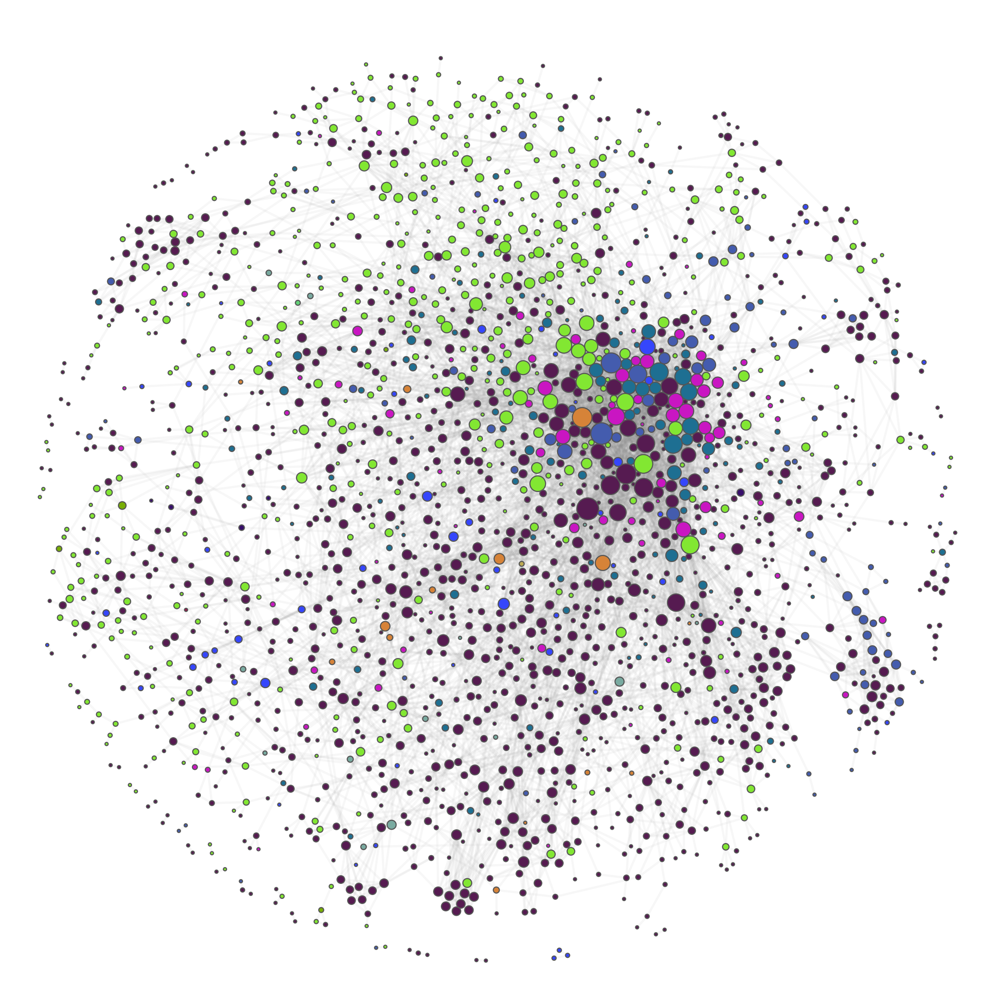

In [59]:
# Note that to get get correct network file for the d3.js visualisation on the website, the network.json must be extracted from ~/netwulf the file is of the format tmp_xxx.json and the time is the same as the time when this code cell is run, you must grab the file before closing the netwulf window, as it deletes the file shortly after. The config file saved here can be used.
if not os.path.exists('plots/network_secondary.json'):
    network, config = nw.visualize(G_un, plot_in_cell_below=False)
    with open('plots/network_secondary.json', 'w') as f:
        json.dump(network, f)
    with open('plots/network_secondary_config.json', 'w') as f:
        json.dump(config, f)
else:
    with open('plots/network_secondary.json', 'r') as f:
        network = json.load(f)
    with open('plots/network_secondary_config.json', 'r') as f:
        config = json.load(f)

fig, ax = plt.subplots(figsize=(10,10),dpi=300)
nw.draw_netwulf(network, fig=fig, ax=ax)
plt.savefig("plots/network_secondary.png")

The figure above is visualised with the colours according to the secondary genre. Comparing this to the random network we visualised earlier it is clear to see that we have distinct nodes that have high density, and smaller nodes with fewer in-degree and out-degrees. It is **not** homogenous.

Now we can try to use the Louvain Partitioning, to see how well that partitions the network

In [60]:
# Louvain pationing
louvain_partition = community.best_partition(G_un) 
nx.set_node_attributes(G_un, louvain_partition, "louvain_group")
louvain_graph = nw.get_filtered_network(G_un, node_group_key='louvain_group') # create filter such that the group are registered in netwulf for colouring

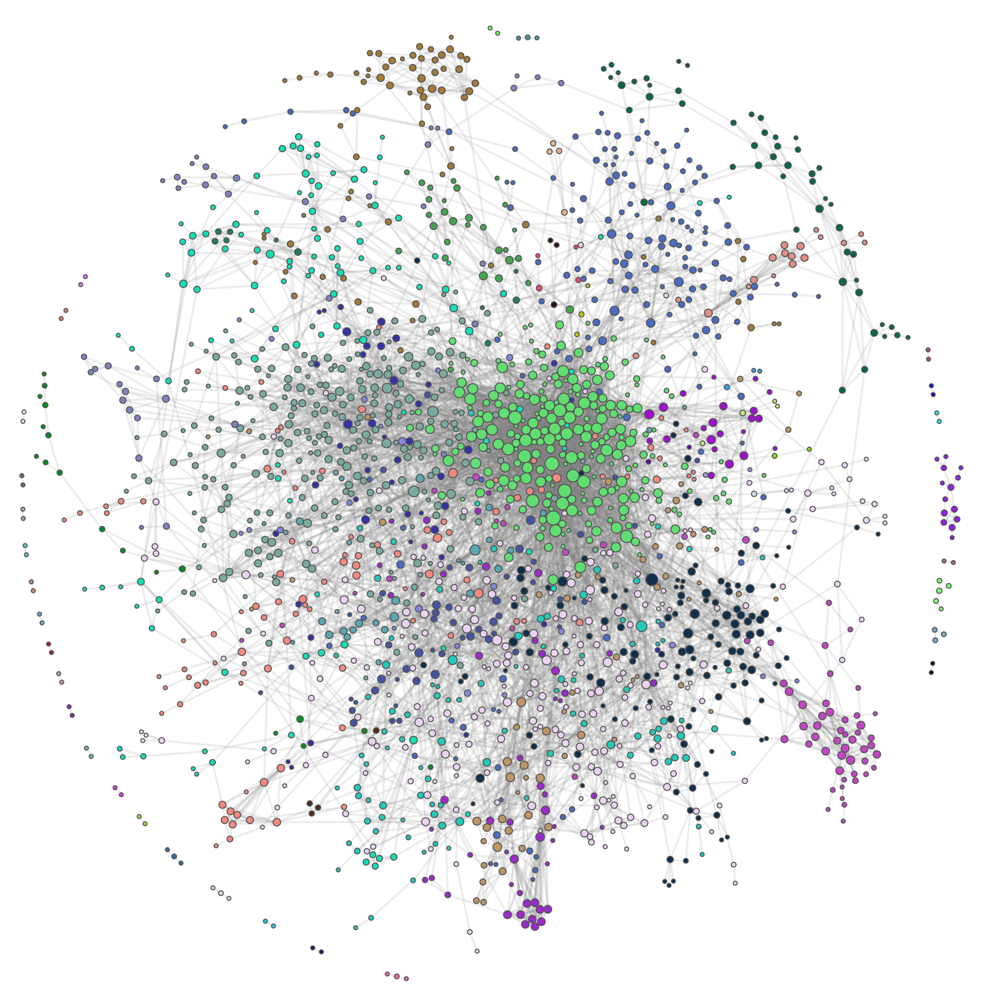

In [61]:
if not os.path.exists('plots/network_community.json'):
    network, config = nw.visualize(louvain_graph, plot_in_cell_below=False)
    with open('plots/network_community.json', 'w') as f:
        json.dump(network, f)
    with open('plots/network_community_config.json', 'w') as f:
        json.dump(config, f)
else:
    with open('plots/network_community.json', 'r') as f:
        network = json.load(f)
    with open('plots/network_community_config.json', 'r') as f:
        config = json.load(f)

fig, ax = plt.subplots(figsize=(10,10),dpi=300)
nw.draw_netwulf(network, fig=fig, ax=ax)
plt.savefig("plots/network_community.png")

The figure above is shown with the colour given by the Louvain partitioning algorithm such that they are divided into communities.

It is now interesting to look at each of the partition's modularities. 

In [62]:
print("Modularity for Second genre partioning")
print(f'(Using FUNCTION): {modularity(G_un, G_un_secondary_genre):.4f}')
print(f'(PYTHON LOUVAIN): {community.modularity(genre_partioning, G_un_secondary_genre):.4f}')
print("")
print("Modularity for Louvain partioning")
print(f'(Using FUNCTION): {modularity(G_un, louvain_graph):.4f}')
print(f'(PYTHON LOUVAIN): {community.modularity(louvain_partition, louvain_graph):.4f}')

Modularity for Second genre partioning
(Using FUNCTION): 0.1379
(PYTHON LOUVAIN): 0.1379

Modularity for Louvain partioning
(Using FUNCTION): 0.6085
(PYTHON LOUVAIN): 0.6085


We observe that the partitioning given by the Louvain algorithm provides a significantly higher modularity than what is given by the secondary genre partition we created ourselves. This indicates that there is a better community structure than the secondary genre.

Let us now compare the partitioning of the genres to see whether they are significantly different from 0 by comparing it to a random graph.


We will perform a small randomization experiment to assess if the modularity we just computed is statitically different from $0$. To do so, we will implement a [configuration model](https://en.wikipedia.org/wiki/Configuration_model). In short, we will create a new network, such that each node has the same degree as in the original network, but different connections. Here is how the algorithm works:

* __a.__ Create an identical copy of the original network. 
* __b.__ Consider the list of network edges. Create two lists: the list of source nodes and target nodes. (e.g. edges = [(1,2),(3,4)], sources = [1,3], targets = [2,4])
* __c.__ Concatenate the list of source nodes and target nodes into a unique list (e.g. [1,3,2,4]). This is the list of _stubs_ (see the [Wikipedia page](https://en.wikipedia.org/wiki/Configuration_model) for the definition of stub).
* __d.__ Shuffle the list of stubs. Build a set of edges (tuples), by connecting each element in the list of shuffled stubs with the following element. (e.g. [4,1,2,3] --> [(4,1),(2,3)])
* __e.__ Remove all the original network edges from the network. Add all the new _shuffled_ edges created in step __d.__

In [63]:
def double_edge_swap(network, N):
    graph = network.copy()
    swap_count = 0
    
    if N < graph.number_of_edges():
        print('Make sure that N is larger than the number of edges!')
        return
        
    while swap_count < N:
        u, v = random.choice(list(graph.edges()))
        x, y = random.choice(list(graph.edges()))
        if u == x or v == x or u == y or v == y :
            continue
        if not graph.has_edge(u, y) and not graph.has_edge(v, x):
            graph.remove_edges_from([(u, v), (x, y)])
            graph.add_edges_from([(u, y), (v, x)])
            swap_count += 1
    
    return graph

In [64]:
_, degrees_swap = zip(*double_edge_swap(G_un, G_un.number_of_edges()).degree())
_, degrees_OG = zip(*G_un.degree())

Just a quick double check that the double edge swap algorithm works 

In [65]:
# Sanity check, the number of edges has to be equal to each other. 
print(f'Number of degrees in the double edge swapped graph: {sum(degrees_swap)}')
print(f'Number of degrees in the original graph: {sum(degrees_OG)}')

Number of degrees in the double edge swapped graph: 14726
Number of degrees in the original graph: 14726


The numbers are the same so it checks out.

Run the double edge swap random graph experiment

In [66]:
if not os.path.exists('cache/random_modularity.pkl'): 
    random.seed(11)
    M = []
    N = 1000 # should be 1000 
    for _ in tqdm(range(N)):
        rand_graph = double_edge_swap(G_un, G_un.number_of_edges()*1.5)
        rand_partition = nw.get_filtered_network(rand_graph, node_group_key='group')
        M.append(modularity(rand_graph, rand_partition))
    with open("cache/random_modularity.pkl", "wb") as f:
        pickle.dump(M, f)
else:
    with open("cache/random_modularity.pkl", "rb") as f:
        M = pickle.load(f)

In [67]:
print(f'(DOUBLE_EDGED_SWAP) Average modularity: {np.mean(M):.4f}')
print(f'(DOUBLE_EDGED_SWAP) STD modularity: {np.std(M):.4f}')

(DOUBLE_EDGED_SWAP) Average modularity: 0.0046
(DOUBLE_EDGED_SWAP) STD modularity: 0.0044


The modularity of the double edge swap random graph is essentially 0, which is to be expected. We will now perform a randomisation experiement with 1000 runs to see if the modularity is significantly different from 0.

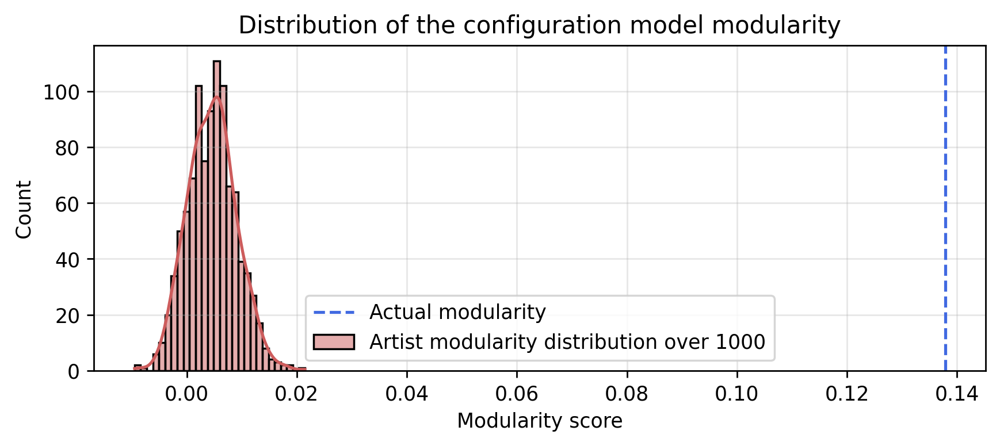

In [68]:
fig, ax = plt.subplots(figsize = (8,3), dpi=250)
sns.histplot(M, kde=True, color='indianred', label='Artist modularity distribution over 1000')
ax.axvline(x=modularity(G_un, G_un_secondary_genre), color='royalblue', ls='--', label = 'Actual modularity')
ax.set_title('Distribution of the configuration model modularity')
ax.set_xlabel('Modularity score')
ax.set_ylabel('Count')
plt.grid(alpha = 0.3)
ax.legend()
plt.savefig('plots/modularity_experiment.png',dpi=500)
plt.show()

It can be seen that the modularity of the genre partitioning is significantly different from 0, so even though it is not the most optimal partitioning, the Louvain partitioning is still better than random.


The communities found by the Louvain algorithm provide a different way to partition the network compared to the partitioning given by the subgenres initially offered. In some ways, the community partition makes more sense, hence it has higher modularity, which is likely due to the fact that hip hop artists tend to have relations with not only those within same subgenres of music but also those who have the same viewpoints as themselves. 

We can observe one large cluster in the middle, and additionally a bunch of clusters with medium-sized closeness -  groups/communities halfway to the edge in the graph, which is how you might expect a community to arise. We will investigate these communities soon.

<a id='louv_vs_group'></a>
### Louvain partitioning vs. group partitioning
We will now investigate how much the two partitioning methods agree. We do this by creating a confusion matrix.

In [69]:
CBP = community.best_partition(G_un)
A = len(set(CBP.values()))
D = np.zeros(shape=(13,A))

for i in range(13):
    for j in range(A):
        # get the nodes according to the i'th club
        nodes = (node for node, data in G_un_secondary_genre.nodes(data=True) if data.get("group") == i)
        subgraph = G_un_secondary_genre.subgraph(nodes)
        # j'th group split
        j_partition = [index for index, value in CBP.items() if value == j]
        # check the overlap between the i'th club and the j'th split
        D[i,j] = len([value for value in j_partition if value in subgraph.nodes])

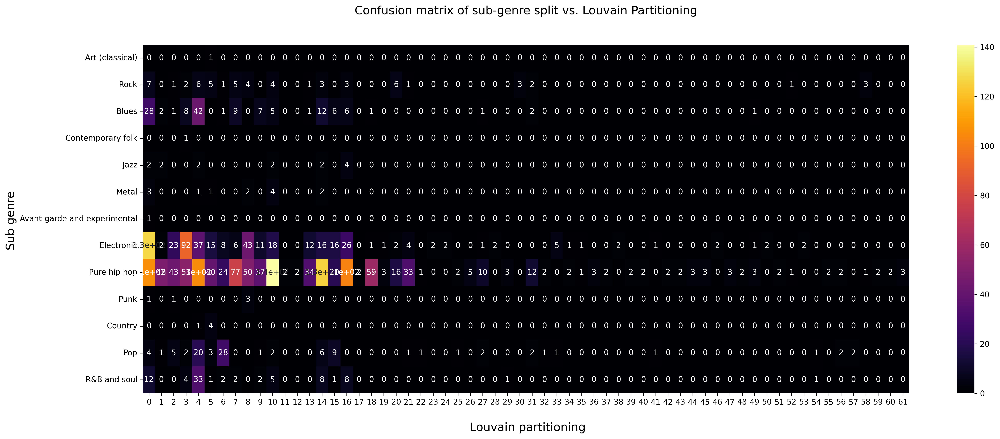

In [135]:
fig, ax = plt.subplots(figsize=(20,8), dpi=300)
sub_genres = list(set(second_genre.values()))
ax = sns.heatmap(D, annot=True, cmap='inferno', yticklabels=sub_genres)
ax.set_title('Confusion matrix of sub-genre split vs. Louvain Partitioning\n\n', fontsize=15);
ax.set_xlabel('\n Louvain partitioning', fontsize=15)
ax.set_ylabel('Sub genre ', fontsize=15)
plt.tight_layout()

From the plotted confusion matrix it is evident that the group partitioning based on the secondary genre does not agree with the Louvain partitioning. More often than not, we have a lot of cells that are equal to 0 and then we have a few sub-genres e.g. Electronic and Pure Hip Hop that contain the most artists from the Louvain partitioning.

One reason why the Louvain partitioning has 60+ partitions is the tendency for smaller communities where maybe two or three artists refer to each other, but they have no other connections. Take for instance Louvain Partition 62, then we only have 2 artists and they are both categorised under the sub-genre Pure Hip Hop.

This might indicate that although our intentions and ideas are good wrt. looking at the partition as based on the artists' secondary genres, the optimal partition is based on another factor. It does, however, seem like the artists in the largest few Louvain partitions all agree to genre partition Electronic and Pure Hip Hop.



<a id='assortativity'></a>
### Assortativity
The assortativity and disassortativity of a network are the tendencies of a network to be divided into hubs where each of the hubs can be connected if it is assortative. Otherwise, if it is the case the hubs avoid linking to each other but instead link to other small degree nodes there is disassortativity.

The assortativity [coefficient](https://en.wikipedia.org/wiki/Assortativity) can be calculated as 

$$r=\frac{\sum_{jk}kj(e_{jk}-q_jq_k)}{\sigma^2_q}$$

(eq. 24) in _Mixing patterns in networks, M. E. J. Newman (2003)_

where $r\in[-1,1]$; $q_k$ is the distribution of the remaining degree i.e. the edges leaving the node that does not connect the pair, it is expressed in terms of the degree distribution $p_k$ as shown further above; $\sigma_q$ is the distribution of $q_k$; $e_{jk}$ is the joint probability distribution of the remaining degrees of the two vertices _j_ and _k_ i.e. the fraction of edges connecting nodes of degree _j_ and _k_.

In [71]:
nx.degree_assortativity_coefficient(G_un)

0.35665821993389035

We get a positive assortativity coefficient, indicating that the hubs in the network connect to each other and the small-degree nodes to small-degree nodes.

Furthermore, we can show the degree correlation matrix of the network:

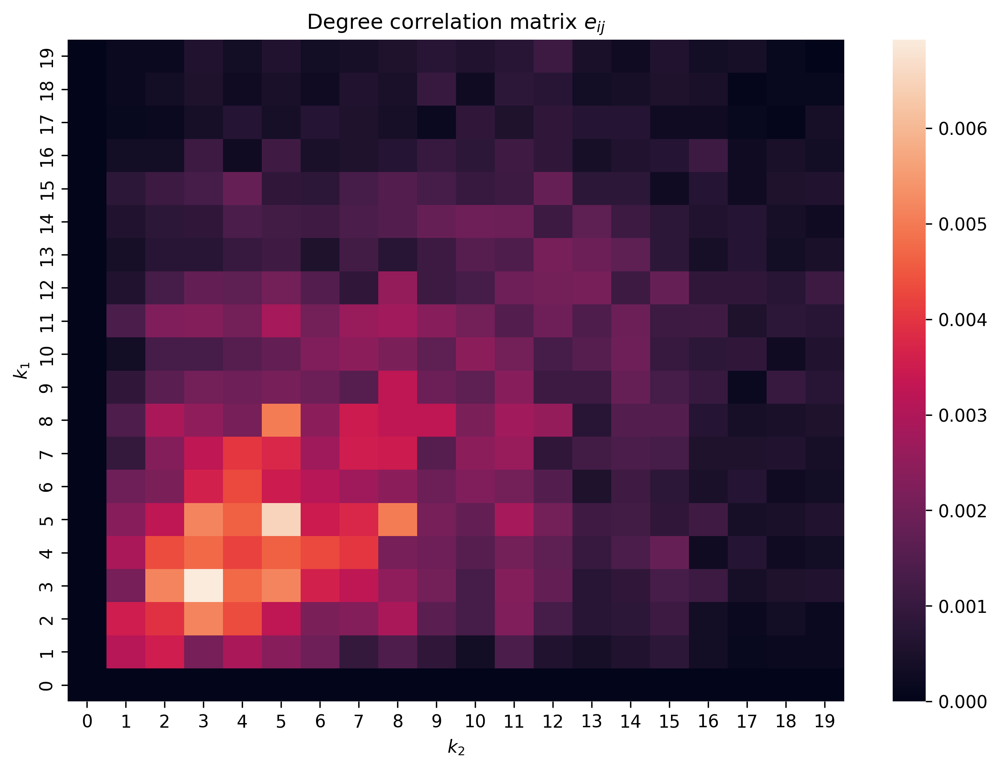

In [72]:
mix_mat = nx.degree_mixing_matrix(G_un)
fig, ax = plt.subplots(figsize=(10,7),dpi=300)
ax = sns.heatmap(mix_mat[0:20,0:20])
ax.invert_yaxis()
ax.set_xlabel('$k_2$')
ax.set_ylabel('$k_1$')
ax.set_title('Degree correlation matrix $e_{ij}$');
plt.savefig('plots/deree_corr_mat.png',dpi=300)

The matrix above shows that $e_{ij}$ is high along the main diagonal. This indicates that nodes of similar degrees tend to link to each other: small-degree nodes to small-degree nodes and hubs to hubs. The matrix has been truncated to only show the smaller degrees as there are only very few nodes with a high degree.

This means that the hip-hop network is structured in such a way that the people who are in hubs tend to connect to each other.

<a id='text'></a>
## Text Analysis

To start with, we initialise by tokenizing the Content attribute of the original dataset.

In [73]:
# apply nltk word_tokenize on the text to create a token column in data
df['tokens'] = df['Content'].apply(word_tokenize)

Based on the _tokens_ attribute of _df_ it is now possible to process the tokens by removing:
1. punctuations
2. URLs
3. stopwords
4. numbers

In [74]:
# Get stopwords from nltk
stop_words = set(w for w in stopwords.words('english'))
def improve_tokens(tokens):
    """
    This function takes in a list of tokens, and removes:
    - punctuation
    - URLs
    - stopwords
    - numbers
    
    as well as setting all words to lower-case
    """
    # Lower-case and punctuations - removes all tokens that are not words
    tokens = [t.lower() for t in tokens if re.search(r'\w+|\S\w', t)]
    # Exclude URLS - remove all tokens that start with www and https
    tokens = [t for t in tokens if re.search(r'^(?!w{3}).*', t)]
    tokens = [t for t in tokens if re.search(r'^(?!https).*', t)]
    # Exclude numbers and stopwords
    tokens = [t for t in tokens if t.isalpha() and t not in stop_words]
    return tokens

In [75]:
# create a column with improved tokens
df["improved_tokens"] = df["tokens"].apply(improve_tokens)

We can now illustrate what the pre-processing of the tokens did to the distribution of document lengths in the entire corpus.

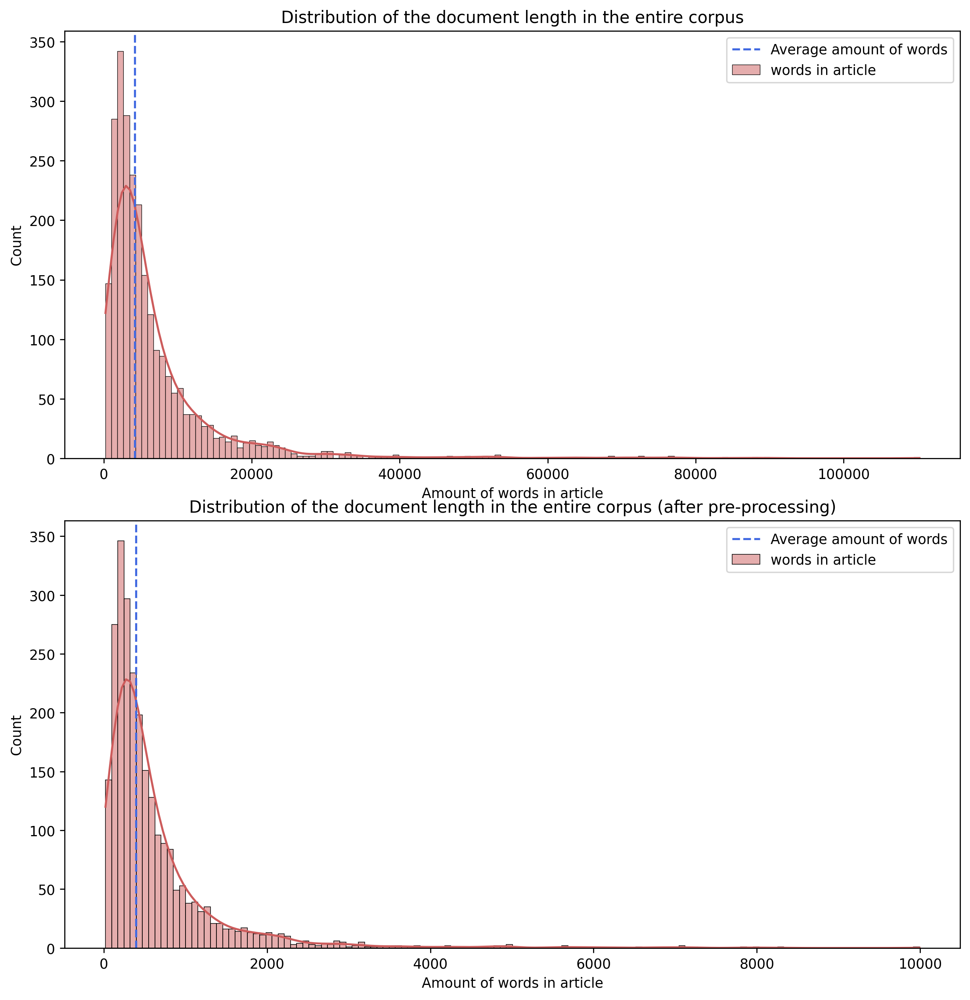

In [76]:
fig, axes = plt.subplots(figsize = (10,5), dpi=250)

content_max = 0
content_min = 10000000
len_list = []
for i in range(len(df.Content)):
    length = len(df.Content[i])
    if length > content_max:
        content_max = length
    if length < content_min:
        content_min = length
    len_list.append(length)

sns.histplot(len_list, kde=True, color='indianred', label='words in article', ax=axes)
axes.axvline(np.median(len_list), color='royalblue', ls='--', label = 'Average amount of words')
axes.set_title('Distribution of the document length in the entire corpus')
axes.set_xlabel('Amount of words in article')
axes.set_ylabel('Count')
plt.grid(alpha = 0.3)
axes.legend()


plt.savefig('plots/distribution_document_length_before.png',dpi=300)
fig, axes = plt.subplots(figsize = (10,5), dpi=250)


content_max = 0
content_min = 10000000
len_list_improved = []
for i in range(len(df.improved_tokens)):
    length = len(df.improved_tokens[i])
    if length > content_max:
        content_max = length
    if length < content_min:
        content_min = length
    len_list_improved.append(length)

sns.histplot(len_list_improved, kde=True, color='indianred', label='words in article', ax=axes[1])
axes.axvline(np.median(len_list_improved), color='royalblue', ls='--', label = 'Average amount of words')
axes.set_title('Distribution of the document length in the entire corpus (after pre-processing)')
axes.set_xlabel('Amount of words in article')
axes.set_ylabel('Count')
plt.grid(alpha = 0.3)
axes.legend()
plt.savefig('plots/distribution_document_length_after.png',dpi=300)
plt.show()

In [77]:
t1 = [np.max(len_list), np.min(len_list), np.mean(len_list), np.median(len_list)]
t2 = [np.max(len_list_improved), np.min(len_list_improved), np.mean(len_list_improved), np.median(len_list_improved)]
a = pd.DataFrame((t1,t2),columns=['Max','Min','Mean','Median'],index=['Before', 'After'])
a.style.bar(height=90,width=99)

,Max,Min,Mean,Median
Before,110250,239,6944.328131,4202.000000
After,9993,21,650.179867,394.000000


The table shows the document stats before and after pre-processing. 

From the plots above we see a clear difference in the document lengths in the corpus. We see that extrema go from 110250 to a mere 9993, and the minimum goes from 239 to 21.

More generally for the data, we go from $\approx$ 6944 to 650 i.e. we see that a large part of the words in each artist's wiki page belong to the set of stopwords, punctuations, numbers and links.

<a id='lexical_diversity'></a>
### Lexical Diversity

We will now as a part of the text analysis look a little into the 'lexical richness' of each Wikipedia page, and look at how they are distributed. The lexical diversity is an interesting measure as it allows us to look at the ratio of different unique words relative to the number of words in the text.

In [78]:
def lexical_diversity(text):
    return len(set(text)) / len(text)

In [79]:
df['lexical_diversity_content'] = df.Content.apply(lexical_diversity)
df['lexical_diversity_improved_tokens'] = df.improved_tokens.apply(lexical_diversity)

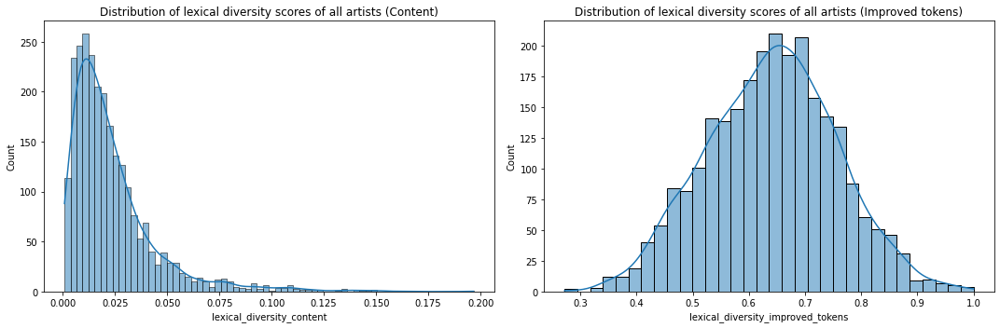

(CONTENT) The artist with the highest lexical diversity is Hades (rapper) with a score of 0.1967
(CONTENT) The artist with the lowest lexical diversity is Kanye West with a score of 0.0009
(CONTENT) The mean lexical diversity is 0.0236


(IMPROVED TOKENS) The artist with the highest lexical diversity is O.G.C. (band) with a score of 1.0000
(IMPROVED TOKENS) The artist with the lowest lexical diversity is Damian Lillard with a score of 0.2720
(IMPROVED TOKENS) The mean lexical diversity is 0.6409


In [80]:
fig, ax = plt.subplots(1,2, figsize = (15,5))
sns.histplot(df.lexical_diversity_content, kde=True, ax=ax[0])
ax[0].set_title("Distribution of lexical diversity scores of all artists (Content)")

sns.histplot(df.lexical_diversity_improved_tokens, kde=True, ax=ax[1])
ax[1].set_title("Distribution of lexical diversity scores of all artists (Improved tokens)")
plt.tight_layout()
plt.show()
print(f"(CONTENT) The artist with the highest lexical diversity is {df.Title[df.index == np.argmax(list(df.lexical_diversity_content.values))].values[0]} with a score of {df.lexical_diversity_content[df.index == np.argmax(list(df.lexical_diversity_content.values))].values[0]:.4f}")
print(f"(CONTENT) The artist with the lowest lexical diversity is {df.Title[df.index == np.argmin(list(df.lexical_diversity_content.values))].values[0]} with a score of {df.lexical_diversity_content[df.index == np.argmin(list(df.lexical_diversity_content.values))].values[0]:.4f}")
print(f"(CONTENT) The mean lexical diversity is {np.mean(list(df.lexical_diversity_content.values)):.4f}")
print("\n")
print(f"(IMPROVED TOKENS) The artist with the highest lexical diversity is {df.Title[df.index == np.argmax(list(df.lexical_diversity_improved_tokens.values))].values[0]} with a score of {df.lexical_diversity_improved_tokens[df.index == np.argmax(list(df.lexical_diversity_improved_tokens.values))].values[0]:.4f}")
print(f"(IMPROVED TOKENS) The artist with the lowest lexical diversity is {df.Title[df.index == np.argmin(list(df.lexical_diversity_improved_tokens.values))].values[0]} with a score of {df.lexical_diversity_improved_tokens[df.index == np.argmin(list(df.lexical_diversity_improved_tokens.values))].values[0]:.4f}")
print(f"(IMPROVED TOKENS) The mean lexical diversity is {np.mean(list(df.lexical_diversity_improved_tokens.values)):.4f}")

As we see from the lexical diversity score we generally have a very low lexical diversity score ranging from 0.0009 to 0.1967, with a mean score of 0.0236. This is not a surprising finding, as Wikipedia pages often seek to use a very formal and generic language. Many stopwords will also affect the lexical diversity score. Just take look at the distribution of tokens before and after pre-processing. We went from an average of 6944 in document length to 650 after pre-processing, i.e. a lot of stopwords and punctuations were removed. This is also reflected in the lexical diversity score, as we see they are much more diverse when stopwords and punctuations are removed. The average lexical diversity score goes from 0.0236 to 0.6409.

An interesting continuation hereof is to look at the distribution of words in the contents of each artist. We do this by first creating a frequency distribution of the text (based on the improved tokens), and from there we can take the text and the top 10 most common words according to the frequency distribution, and plot a dispersion plot. This allows us to visualise where and how many times the words are used in the text.

To show this, we will exemplify it by using Drake (musician) as our test subject. Mind the frequency distribution will be calculated based on the improved tokens. If one were to simply use the plain text then it would be evident that the words that are used the most are stopwords and punctuations. However, since these are less fun to look at, we only look at the improved tokens.

In [81]:
text = nltk.Text(list(df.improved_tokens[df.Title == "Drake (musician)"].values[0]))
fdist = nltk.FreqDist(text)
fdist.most_common(10)

[('drake', 300),
 ('album', 88),
 ('music', 75),
 ('also', 75),
 ('released', 71),
 ('later', 62),
 ('one', 54),
 ('billboard', 47),
 ('single', 46),
 ('song', 46)]

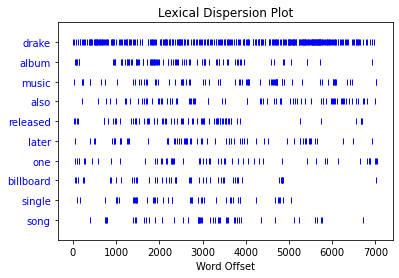

In [82]:
text.dispersion_plot(["drake", "album", "music", "also", "released", "later", "one", "billboard", "single", "song"])

From the dispersion plot up above it is obvious that it makes sense that "Drake" is mentioned the most in an article about Drake. Since we are dealing with an encyclopedia article that seeks to describe a specific person that creates _music_ and _releases_ _songs_ on different _albums_, it only makes sense that these words are the ones occurring the most.

Since this investigation of lexical diversity and dispersion plots does not show anything out of the ordinary, we decided not to include it on the website.

<a id='sentiment_analysis'></a>
### Sentiment Analysis
We will now look a bit more into the sentiment analysis, and to perform such an analysis we use the [hedonometer](https://hedonometer.org/about.html) dataset.

In [83]:
labMT = pd.read_csv("Hedonometer.csv", index_col="Rank")

We now define a function that takes in a list of tokens, and then gives them a sentiment score to that token:

In [84]:
def get_happiness_score(text):
    token_list = [w for w in text if w in labMT['Word'].values]
    fd = nltk.FreqDist(token_list)
    hT = 0
    for w in set(token_list):
        h_avg = labMT["Happiness Score"][labMT["Word"]==w]
        if len(h_avg) > 0:
            hT += h_avg.item() * fd.freq(w)

    return hT

Now calculating the sentiment score for each artist can take some time. We however already ran it and saved the dataset, such that it can be easily loaded.

In [85]:
# takes 25 min to run
if not os.path.exists('cache/happiness.pkl'): 
    df["happiness_score"] = df["improved_tokens"].apply(get_happiness_score)
    a = list(df["happiness_score"])
    with open('cache/happiness.pkl', 'wb') as f:
        pickle.dump(a, f)
else:
    with open('cache/happiness.pkl', 'rb') as f:
        a = pickle.load(f)
    df["happiness_score"] = a 

Let's take a look at who has the most positive and negative sentiment

The most positively mentioned person is Corey Jackson with a "happiness" score of 6.3

In [86]:
print(np.argmax(df.happiness_score.values), max(df.happiness_score.values))
df[df.index == np.argmax(df.happiness_score.values)]

37 6.308053691275171


,index,Title,Categories,Links,Content,Genre,artist_links,birthdate,is_dead,infobox,secondary_genre,tokens,improved_tokens,lexical_diversity_content,lexical_diversity_improved_tokens,happiness_score
37,37,Corey Jackson (rapper),"[2006 births, 21st-century African-American mu...","[21 Savage, Birdman (rapper), CNN, Dallas, Ess...","Corey Jackson (born July 16, 2006), better kno...",hip-hop,"[Jazze Pha, Birdman (rapper), 21 Savage, Young...",2006-07-16,False,"[Jackson, Mississippi, Young Thug, Birdman (ra...",Pure hip hop,"[Corey, Jackson, (, born, July, 16, ,, 2006, )...","[corey, jackson, born, july, better, known, st...",0.030542,0.674157,6.308054


The most negatively mentioned person is Dexter with a score of 5.06

In [87]:
print(np.argmin(df.happiness_score.values), min(df.happiness_score.values))
df[df.index == np.argmin(df.happiness_score.values)]

1470 5.061132075471699


,index,Title,Categories,Links,Content,Genre,artist_links,birthdate,is_dead,infobox,secondary_genre,tokens,improved_tokens,lexical_diversity_content,lexical_diversity_improved_tokens,happiness_score
1470,1479,Dexter (singer),"[All articles to be expanded, All articles wit...","[509-E, Brasil de Fato, Education, Estadão, GO...","Marcos Fernandes de Omena (São Paulo, 1973), m...",hip-hop,"[MV Bill, Mano Brown]",None,False,[UNK],Pure hip hop,"[Marcos, Fernandes, de, Omena, (, São, Paulo, ...","[marcos, fernandes, de, omena, são, paulo, kno...",0.074401,0.821918,5.061132


The general distribution of all the different sentiment scores can be seen for all artists:

In [147]:
fig = px.histogram(df, x="happiness_score",  marginal="box")
fig.update_layout(
    title_text='Distribution of happiness score across all wikipedia pages from current dataset',
    xaxis = dict(
        title='Happiness Score'),
    yaxis=dict(
        title='Count'))
fig.write_json("plots/dist_of_happiness_score.json")
fig.show()

What generally can be said from this plot is that all the wikipages are rather neutral in their language. The hedonometer ranges between 1 and 9 where 1 is sad to 9 being happy, i.e. 5 equates to being neutral. We see that the median lies around 5.78 i.e. a little more on the positive site, however, not to such an extent as being able to deem it _positive_. This plot does not really tell us anything different from our expectations that Wikipedia is in fact rather neutral.

Let us take a look at the sentiment score for each of the most popular hip hoppers as we found earlier:

In [89]:
score = [df.happiness_score[df.Title == artist].values[0] for artist in max_in_deg]

In [90]:
t3 = pd.DataFrame(score,max_in_deg, columns=['Sentiment score'])
t3.style.bar(height=95)

,Sentiment score
Jay-Z,5.826573
Lil Wayne,5.673841
Kanye West,5.795107
Eminem,5.599351
Snoop Dogg,5.582524
50 Cent,5.629452
Nas,5.694526
Busta Rhymes,5.717329
Drake (musician),5.796930
Kendrick Lamar,5.799031


Again we see that although the artists are different people, their Wikipedia encyclopedia pages are equally neutral. This is again expected as Wikipedia themselves seek to be as generic and formal in their language as possible.

<a id='tf_idf'></a>
### TF-IDF

The Term Frequency–Inverse Document Frequency (TF-IDF) is a fascinating numerical statistic when doing information retrieval of some documents. As the method's name implies, there are two main ideas behind this statistic; the frequency of the term in a document and how frequent documents contain the term. The equation for the Term Frequency (TF) has the following form: 


$$\text{tf}(t,d)=\frac{f_{t,d}}{\sum_{t’\in d} f_{t’,d}}$$
Where $f_{t,d}$ is the number of times the term ${t}$ appears in the document ${d}$, hence the TF score is the ratio of the use of a word compared to all words in the document. 

The Inverse Document Frequency (IDF) has the equation: 

$$\text{IDF}(t,d)=\log \frac{N}{|\{ d\in D: t\in d\}|}$$
Where the N is the number of documents and $|{d \in D: \in d}|$ is the number of documents where the term is.

The TF-IDF score for each term in each document will then be calculated with

$$\text{tfidf}(t,d,D)=\text{tf}(t,d)\cdot\text{idf}(t,D)$$
Where it becomes apparent, the terms which will get the highest score are the terms where only a few documents contain that term, and the document has many instances of that term. 

Thereby this statistic can find the words that make a document (Wikipedia page) unique, and that is exactly what we wish to figure out. We want to find the defining words for each of our hip hop artists; the words that are unique to them and, therefore likely informative about their lives. 


In [91]:
def TF(document:dict, top=None, value=True):
    """
    input: document - a dictionary if documents with ticker tokens as keys and tokens as values
    input: top - None as default. If selected to be e.g. 5 then the top 5 TF words will be returned
    input: values - True as default. If True then it returns the TF value otherswise only the name.
              - value is only relevent  if top != None
              
    return: dictionary of TF for all words if top == None
    return: list of stock names, dictionary of stock names and their appertaining tf values.
    """
    if top != None:
        fd = nltk.FreqDist(document).most_common(top)
        TF_dict = {}
        TF_list = []
        for i in range(top): 
            td = (fd[i][1]/(len(document)))
            if value:
                TF_dict[fd[i][0]] = round(td,4)
            else:
                TF_list.append((fd[i][0]))
        return TF_list, TF_dict
    else:
        fd = dict(nltk.FreqDist(document))
        A = []
        for key in fd.keys():
            A += [(key, fd[key]/len(document))]
        return dict(A)

def IDF(docList:dict, artists) -> dict:
    """
    input: documents - dictionary of all documents
    input: artists - list of artists to limit the corpus
    
    return: idf - dictionary of {token: idf value}}
    """
    
    N = len(list(docList.keys()))
    idf = {}
    
    all_terms = []
    for i in docList.keys():
        all_terms+=(docList[i]) 
    all_terms = set(all_terms)
    
    counter = dict.fromkeys(all_terms, 0)
    for doc in artists:
        for token in set(docList[doc]):
            counter[token] += 1
            
    for key, occurences in counter.items():
        idf[key] = math.log10(N /(occurences+1))
    return idf
    
def TF_IDF(tf:dict, idf:dict, artists:list) -> dict:
    tf_idf = {}
    for stock in artists:
        tf_idf_tokens = {}
        for token in list(tf[stock].keys()):
            tf_idf_tokens[token] = idf[token]*tf[stock][token]
        tf_idf[stock] = tf_idf_tokens
    return tf_idf

#### TF-IDF person wise
We start by creating a document for each artist/person.

In [92]:
# one document per person
documents = dict(zip(df.Title, df.improved_tokens))

we then calculate the tf_idf score:

In [93]:
tf = {}

for person in documents.keys():
    tf[person] = TF(documents[person])

idf = IDF(documents, list(documents.keys()))
    
tf_idf = TF_IDF(tf, idf, list(documents.keys()))

In the cell below we see three of the many artists in the documents dictionary, with their respective top five TF-IDF words.

In [94]:
for person in list(documents.keys())[:3]:
    temp = dict(sorted(tf_idf[person].items(), key=lambda item: item[1], reverse=True)[:10])
    print(f"Person: {person.upper()}:")
    t = pd.DataFrame(list(temp.items())[:5],columns=['word', 'TF-IDF score'])
    display(t.style.bar())

Person: ISHMAEL BUTLER:


,word,TF-IDF score
0,butler,0.097318
1,digable,0.055681
2,planets,0.052608
3,ishmael,0.043843
4,palaces,0.031185


Person: ZEUS (MUSICIAN):


,word,TF-IDF score
0,zeus,0.068009
1,freshly,0.017964
2,botswana,0.017783
3,flipside,0.015663
4,baked,0.014188


Person: C-NOTE (RAPPER):


,word,TF-IDF score
0,botany,0.120892
1,birds,0.040131
2,boyz,0.035379
3,vs,0.029891
4,coast,0.029222


Lets take a look a Kanye West, a popular hip hop musician. Figure out what the top 10 words are by their TF and TF-IDF scores.   

In [95]:
person = 'Drake (musician)'
temp = dict(sorted(tf[person].items(), key=lambda item: item[1], reverse=True)[:10])
print(f"Person: {person}:")
t = pd.DataFrame(list(temp.items())[:10],columns=['word', 'TF score'])
t.style.bar()

Person: Drake (musician):


,word,TF score
0,drake,0.042457
1,album,0.012454
2,music,0.010614
3,also,0.010614
4,released,0.010048
5,later,0.008774
6,one,0.007642
7,billboard,0.006652
8,single,0.006510
9,song,0.006510


In [96]:
person = 'Drake (musician)'
temp = dict(sorted(tf_idf[person].items(), key=lambda item: item[1], reverse=True)[:10])
print(f"Person: {person}:")
t = pd.DataFrame(list(temp.items())[:10],columns=['word', 'TF-IDF score'])
t.style.bar()

Person: Drake (musician):


,word,TF-IDF score
0,drake,0.043364
1,toronto,0.006816
2,ovo,0.004373
3,graham,0.003305
4,hot,0.003166
5,care,0.002859
6,billboard,0.002852
7,lover,0.002699
8,number,0.002538
9,canadian,0.002437


Unsurprisingly, Drake himself shows up as the top word in each case. However, the TF-score words are extremely irrelevant since they are just generic music terms that provide absolutely no information on him as a person. In contrast, the TF-IDF words are highly relevant. For example, the OVO music label which Drake owns, is shown.


<a id='top_100_tf_idf'></a>

### Sentiment based on the top 100 TF-IDF words from each person

Given that Wikipedia is notoriously neutral in their writing, the results of just doing a sentiment analysis on all their content would be uninteresting. Instead, we thought it would be interesting to look at each artist's top 100 words from the TF-IDF scores. In that way, the considered words hold much more weight and can better describe the artist's true sentiment 

In [97]:
top_words =  {}
for person in documents.keys():
    top_words[person] = dict(sorted(tf_idf[person].items(), key=lambda item: item[1], reverse=True)[:100])

a = list(top_words.values())
b = [list(i.keys()) for i in a]
df['top_tokens'] = b

In [98]:
if not os.path.exists('cache/happiness_score_top.pkl'):
    df['happiness_score_top'] = df["top_tokens"].apply(get_happiness_score) 
    a = list(df['happiness_score_top'])
    with open("cache/happiness_score_top.pkl", "wb") as f:
        pickle.dump(a, f)
else:
    with open("cache/happiness_score_top.pkl", "rb") as f:
        a = pickle.load(f)
    df['happiness_score_top'] = a

In [99]:
print(np.argmax(df.happiness_score_top.values), max(df.happiness_score_top.values))
df[df.index == np.argmax(df.happiness_score_top.values)]

959 6.339069767441859


,index,Title,Categories,Links,Content,Genre,artist_links,birthdate,is_dead,infobox,secondary_genre,tokens,improved_tokens,lexical_diversity_content,lexical_diversity_improved_tokens,happiness_score,top_tokens,happiness_score_top
959,964,Ziggy Marley,"[1968 births, All BLP articles lacking sources...","[2010 California Proposition 19, 24th Grammy A...","David Nesta ""Ziggy"" Marley (born 17 October 19...",hip-hop,"[Will Smith, Sean Paul, Lauryn Hill, Stephen M...",1968-10-17,False,"[Kingston, Jamaica, Bambaata Marley, Bob Marle...",Pure hip hop,"[David, Nesta, ``, Ziggy, '', Marley, (, born,...","[david, nesta, ziggy, marley, born, october, j...",0.00628,0.514907,6.104528,"[marley, ziggy, makers, melody, nesta, gong, c...",6.33907


In [100]:
print(np.argmin(df.happiness_score_top.values), min(df.happiness_score_top.values))
df[df.index == np.argmin(df.happiness_score_top.values)]

1718 4.3676744186046506


,index,Title,Categories,Links,Content,Genre,artist_links,birthdate,is_dead,infobox,secondary_genre,tokens,improved_tokens,lexical_diversity_content,lexical_diversity_improved_tokens,happiness_score,top_tokens,happiness_score_top
1718,1731,Drakeo the Ruler,"[1993 births, 2021 deaths, 2021 murders in the...","[03 Greedo, 50 Cent, ASCAP, Bubbling Under Hot...","Darrell Wayne Caldwell (December 1, 1993 – Dec...",hip-hop,"[YG (rapper), 50 Cent, Ice Cube, Drake (musici...",1993-12-01,True,"[Los Angeles, California, Murder, West Coast h...",Pure hip hop,"[Darrell, Wayne, Caldwell, (, December, 1, ,, ...","[darrell, wayne, caldwell, december, december,...",0.012786,0.706478,5.334125,"[caldwell, drakeo, jail, flamming, uchies, gtl...",4.367674


In [101]:
score_t = [df.happiness_score_top[df.Title == artist].values[0] for artist in max_in_deg]
t3 = pd.DataFrame(score_t,max_in_deg, columns=['Sentiment score'])
t3.style.bar(height=95)

,Sentiment score
Jay-Z,5.685846
Lil Wayne,5.509155
Kanye West,5.841605
Eminem,5.225857
Snoop Dogg,5.268065
50 Cent,5.184375
Nas,5.673158
Busta Rhymes,5.402899
Drake (musician),5.813472
Kendrick Lamar,5.652639


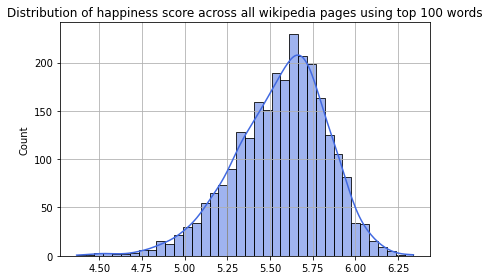

In [102]:
sns.histplot(df.happiness_score_top.values, kde=True,  color='royalblue')
plt.grid()
plt.title("Distribution of happiness score across all wikipedia pages using top 100 words")
plt.tight_layout()
plt.savefig('plots/distribution_happiness_top100.png',dpi=300)
plt.show()

Using the top 100 words does not seems to change much compared to using all the words.

<a id='age_vs_sentiment'></a>
### Age vs. sentiment

Even though the sentiment is very neutral, we can investigate if there is any trend in the sentiment with regards to the age of the hip hopper

In [103]:
UTC = calendar.timegm(df.birthdate[1].timetuple())
birtdate_as_unix = np.array([calendar.timegm(i.timetuple()) if i is not None  else None for i in df.birthdate])
r, p = stats.pearsonr(birtdate_as_unix[birtdate_as_unix != None], df.happiness_score[birtdate_as_unix != None])
r, p

(0.23074650251214868, 5.109265168232513e-27)

In [104]:
fig = px.scatter(df, x="birthdate", y="happiness_score",hover_data=['Title'], size_max=60)

fig.update_traces(textposition='top center')
fig.update_layout(
    title_text='Artist birthdate wrt. sentiment score of their Wiki-Pages'
)
fig.write_json("plots/age_scatter_plotly.json")
fig.show()

As can be seen from the correlation coefficent $r=0.23$ there is a slight positive correlation, which can also slighty be seen in the plots above. Notice that the points lean slightly upwards. However, the trend is not strong.

In [105]:
birth_year = [str(item.year) if item != None else None for item in df.birthdate]
df['birth_year'] = birth_year

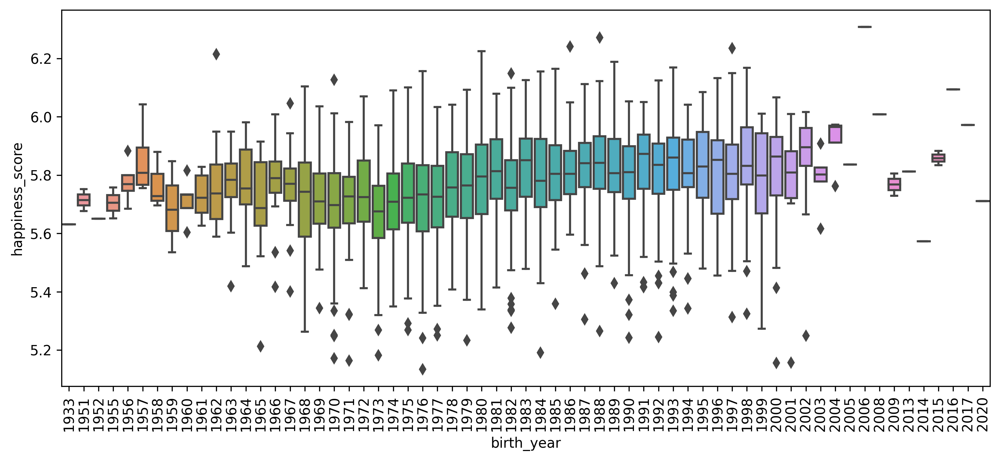

In [106]:
fig, ax = plt.subplots(figsize=(12,5), dpi=300)
sns.boxplot(x='birth_year', y='happiness_score', data=df.sort_values(by=['birth_year']))
plt.xticks(rotation=90)
plt.savefig('plots/birth_age.png',dpi=300)
plt.show()

The figure above shows a boxplot for each of the respective birth years. Overall there seems to be a very slight upwards trend with wiki pages about artists before 1980 having lower happiness_scores. However, although there seems to be a slight trend, it does not seem to be that prominent - also accounting for the limited data we have as seen under section [distribution of birth dates](#dist_birthdates). Drawing further conclusions about the evolution of formal language, and thereby sentiment score, on Wikipedia can't be made solely on the data from this project.

<a id='wordclouds'></a>
### Word clouds

First we are going to shows the word clouds of the artists that we personally find interesting. They are shown in the list below

In [107]:
artistz = ['Eminem', 'Kanye West', 'Kendrick Lamar', 'Drake (musician)', 'Jay-Z', '50 Cent', 'Nicki Minaj', 'Snoop Dogg', 'Cardi B', 'Dr. Dre']

In [108]:
interesting_dict = {}
for artist in artistz:
    interesting_dict[artist] = tf_idf[artist]

Now we will generate a word cloud for each of the persons

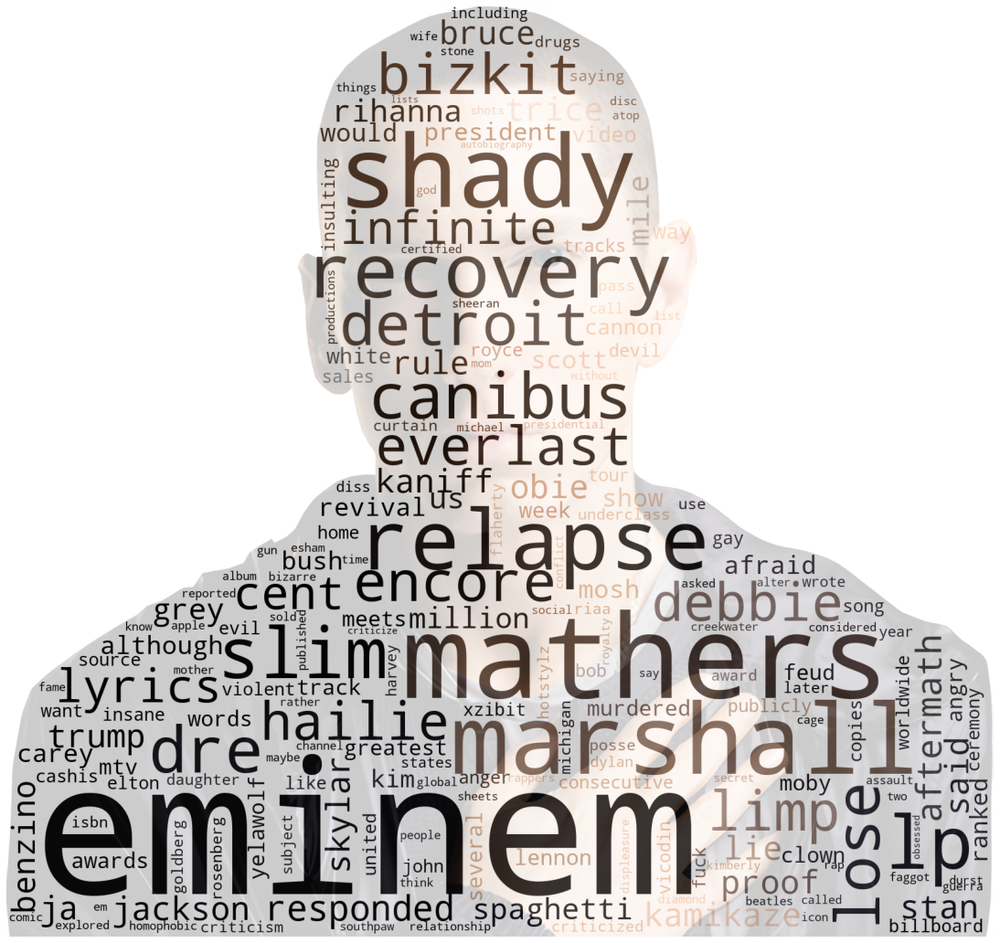

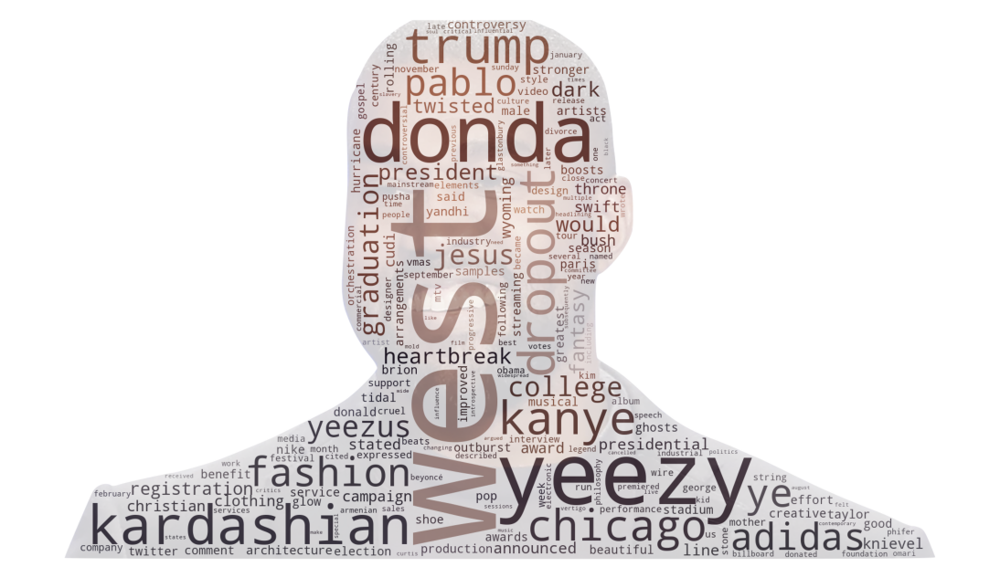

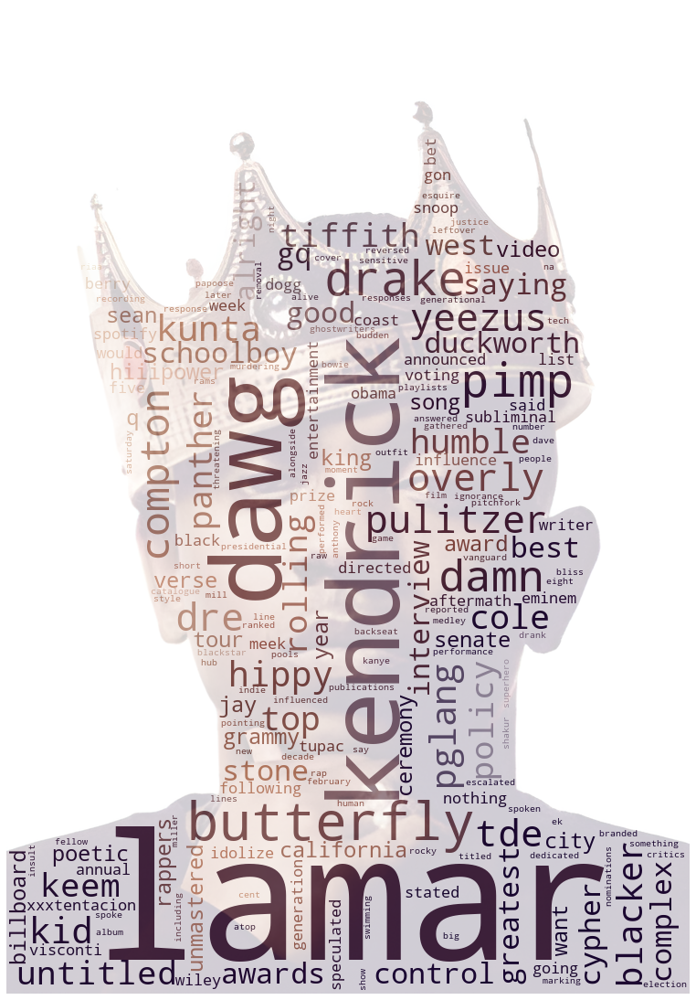

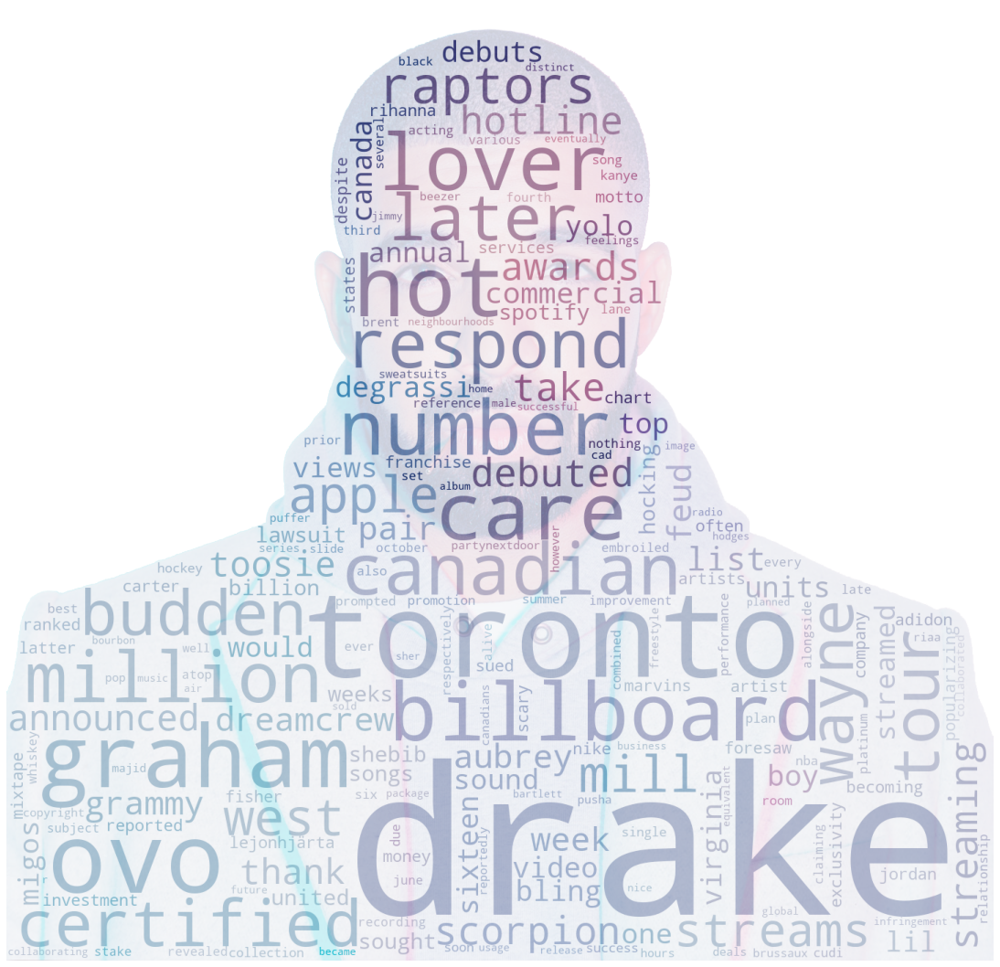

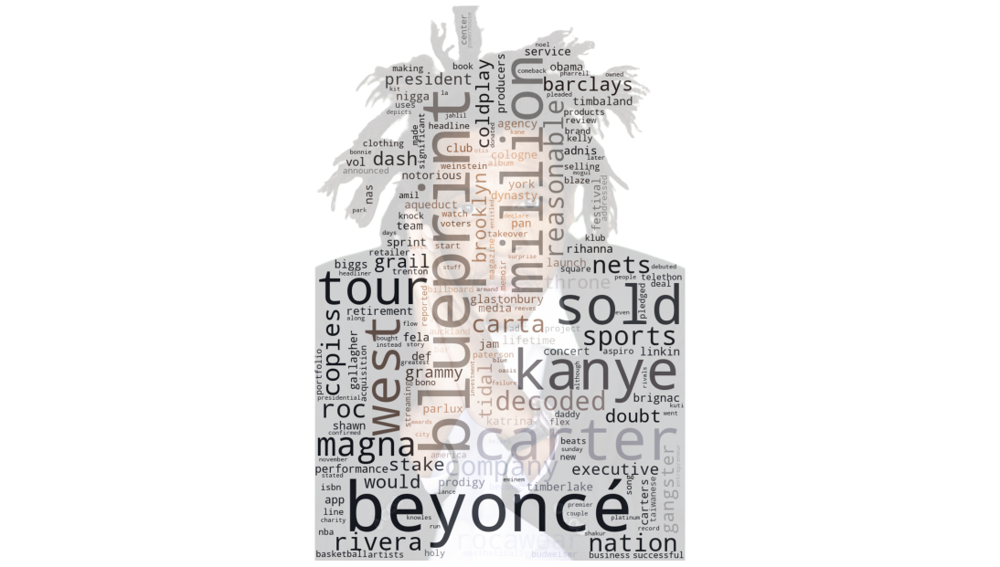

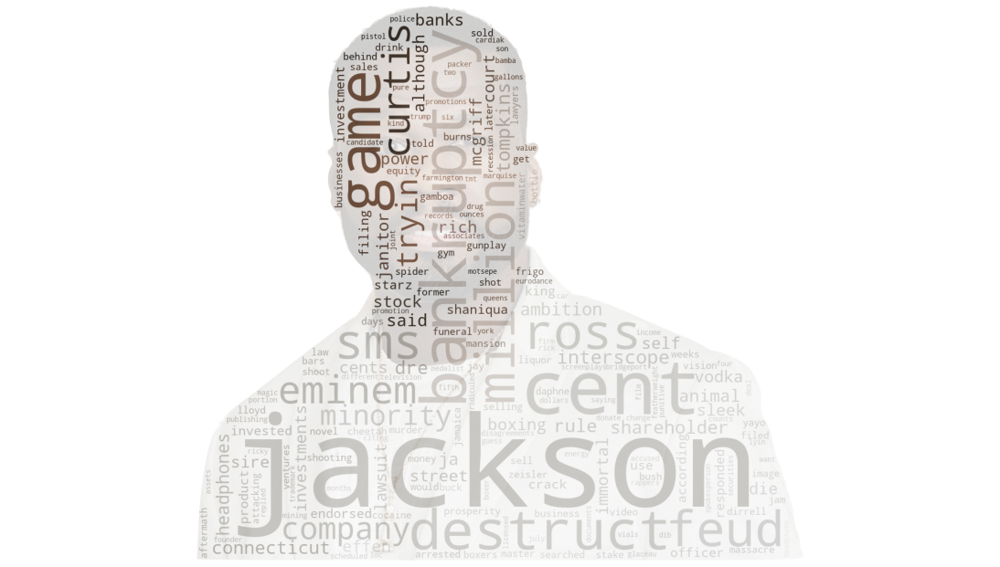

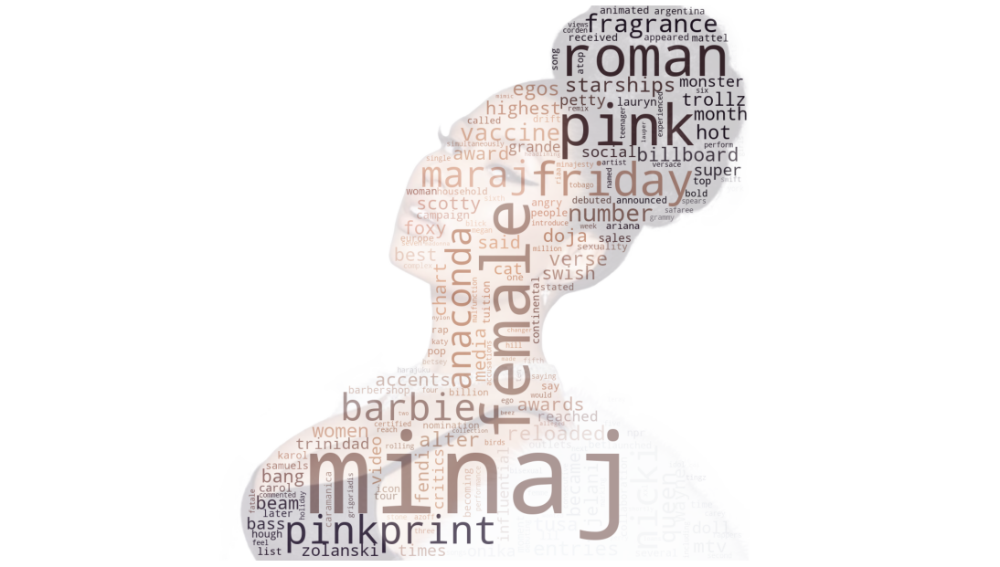

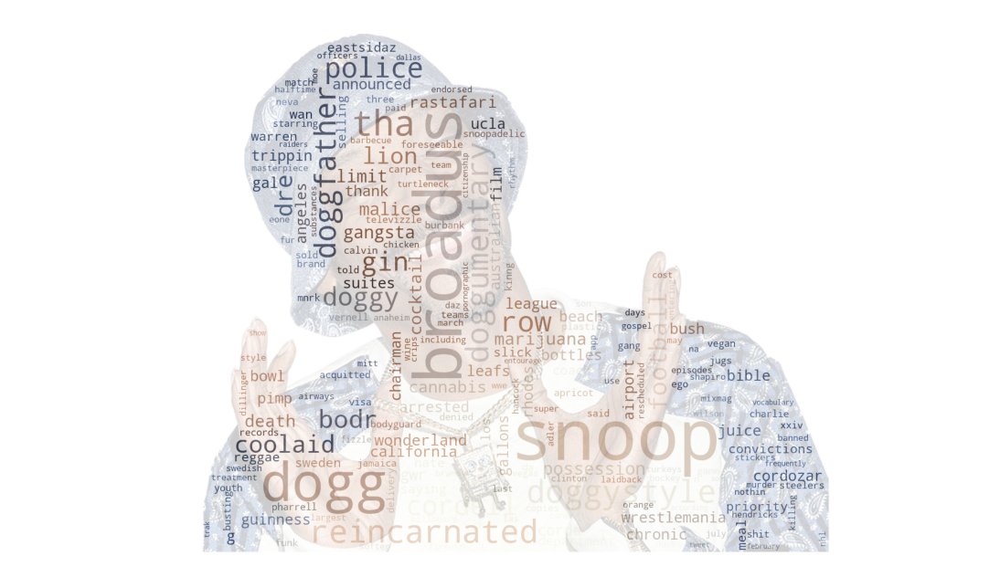

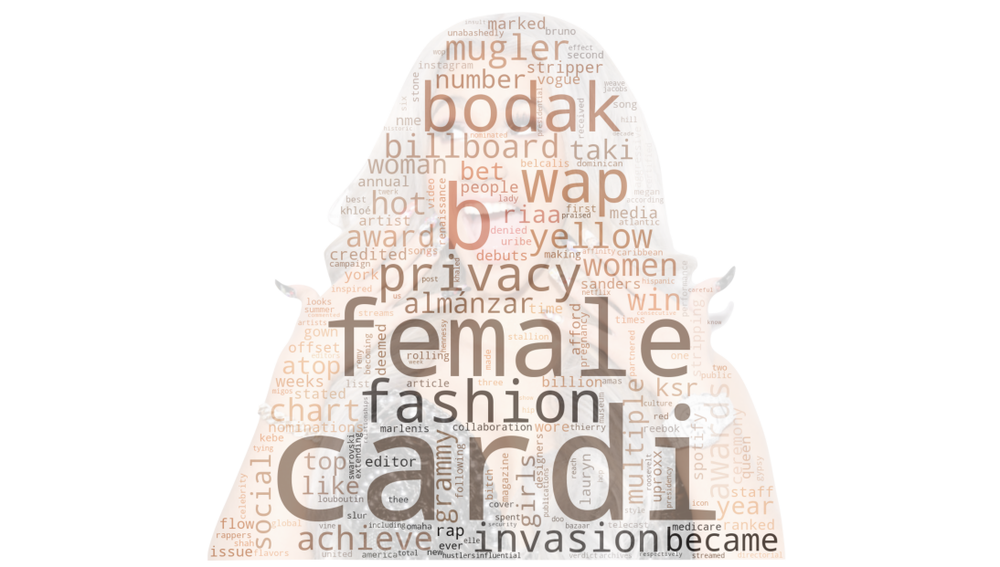

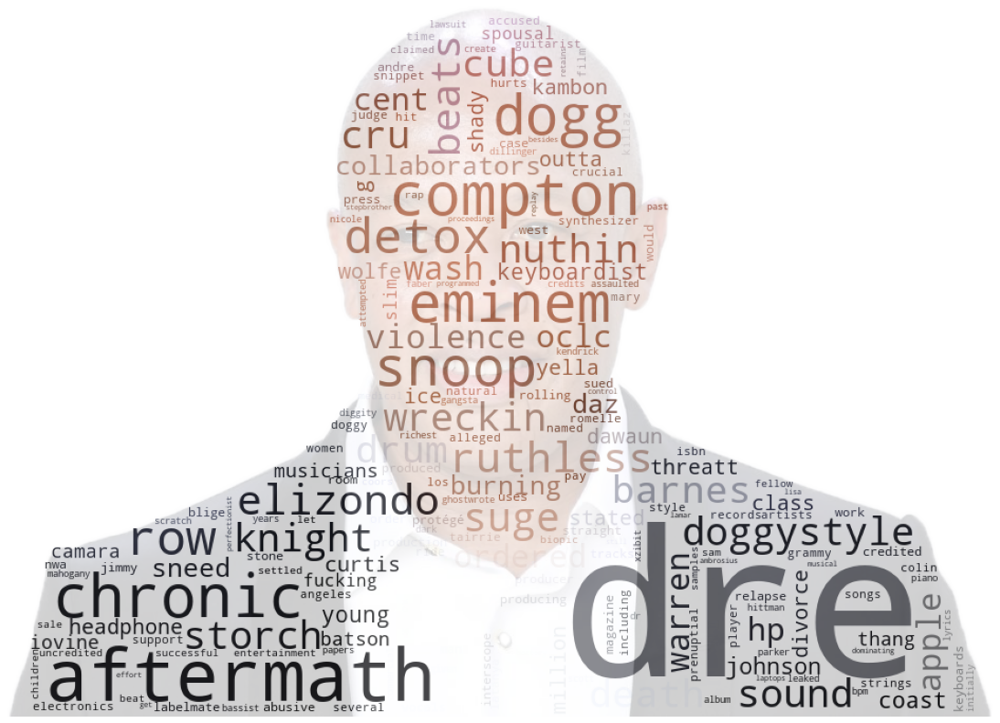

In [109]:
for key in artistz:
    fig, ax = plt.subplots(figsize=(15,15))
    d = path.dirname(__file__) if "__file__" in locals() else os.getcwd()
    # read the mask / color image taken from
    # http://jirkavinse.deviantart.com/art/quot-Real-Life-quot-Alice-282261010
    try:
        mask = np.array(Image.open(path.join(d, f"images/{key}.png")))
    except:
        mask = np.array(Image.open(path.join(d, f"images/{key}.jpg")))
        
    stopwords = set(STOPWORDS)
    stopwords.add("said")

    wc = WordCloud(background_color="white", stopwords=stopwords, mask=mask, width=5000, height=5000, 
                        max_words=200, max_font_size=300, 
                        min_font_size=1)
    # generate word cloud
    wc.fit_words(interesting_dict[key])
    # create coloring from image
    image_colors = ImageColorGenerator(mask)
    # we could also give color_func=image_colors directly in the constructor
    ax.imshow(wc.recolor(color_func=image_colors))
    ax.imshow(mask, alpha=0.2)
    ax.axis('off')
    plt.tight_layout(pad=0)
    plt.savefig(f"wordclouds/{key}.png", format = 'png', dpi=300)
    plt.show()

The word clouds of each person tell some interesting and very informative things about them. In nearly all the cases their name is displayed prominently on the word cloud. For example, in the case of Nicki Minaj we see some of her songs like 'Anaconda and starships', we see some of her nicknames, like barbie, along with a lot of other things that are specific to her. The reason for this is that we see that the names of the artists are mentioned multiple times within their own Wikipedia page, and much less among other pages.

We know that the TF-IDF score is used to visualise and find the words that are the most unique for each artist. Take for an instance Drake - in his word cloud we see words that specifically describe him e.g. OVO (a record label founded by Drake in 2012), Canadian and Toronto, billboard etc. All words that are related to 1. where he is from, 2. what he does and 3. the fact that he has won multiple billboard rewards. Words such as lawsuit are also prominent for Drake, relating to some of the controversies and legal issues he has had. The same is evident for artists such as Kanye West where we see Kardashian relating to his ex-wife, Rocawear for Jay-Z relating to a [hip hop fashion line worth more than half a billion](https://www.thesportsman.com/style/how-jay-z-built-rocawear-the-hip-hop-fashion-line-worth-more-than-half-a-billion) dollars he founded. 

Especially interesting is Dr.Dre, an old-school hip hop producer and rapper. His word cloud is filled with the names of other artists such as Eminem, 50 Cent, Snoop Dogg, Ice Cube and more, where most of them relate to back when he produced music under the record labels Deathrow and Aftermath Entertainment etc.

<a id='top5_wordclouds'></a>
### Looking at the top 5 highest and lowest artists wrt. sentiment score.

In [110]:
zipped_lists = zip(df.happiness_score.values, df.Title.values)
sorted_pairs = sorted(zipped_lists)

tuples = zip(*sorted_pairs)
_, artists = [ list(tuple) for tuple in  tuples]

top_5_sentiment = artists[-5:]
lowest_5_sentiment = artists[:5]
print(f"Top five highest artists based on sentiment score:\n {top_5_sentiment}")
print(f"Top five lowest artists based on sentiment score:\n {lowest_5_sentiment}")

Top five highest artists based on sentiment score:
 ['Randa (rapper)', 'Joeboy', 'DJ Webstar', 'Moncho', 'Corey Jackson (rapper)']
Top five lowest artists based on sentiment score:
 ['Dexter (singer)', 'Big Lurch', 'Tay-K', 'SpotemGottem', 'C-Murder']


In [111]:
top_5_dict = {}
lowest_5_dict = {}

for artist in top_5_sentiment:
    top_5_dict[artist] = tf_idf[artist]
    
for artist in lowest_5_sentiment:
    lowest_5_dict[artist] = tf_idf[artist]

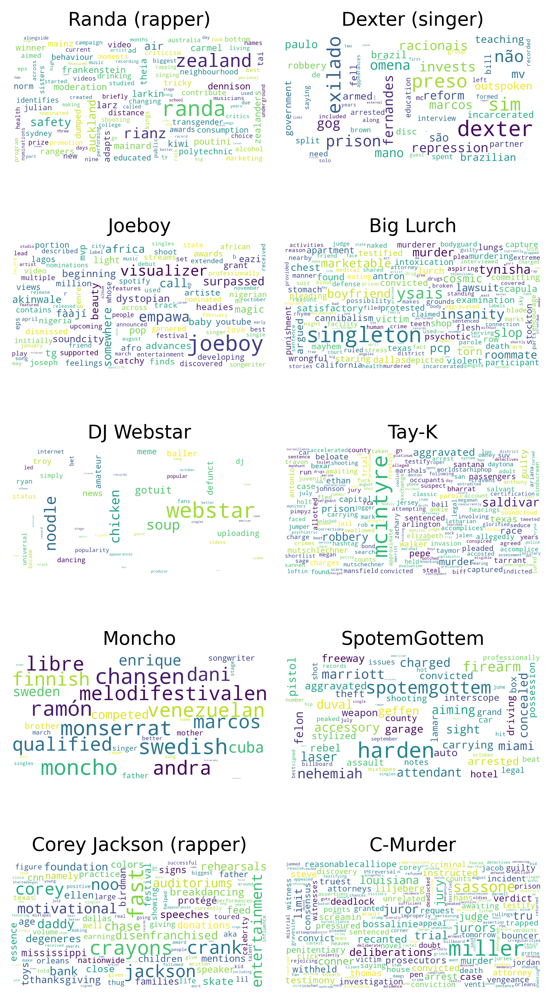

In [112]:
fig, ax = plt.subplots(5, 2, figsize=(5,10),dpi=500)

for j in range(2):
    if j == 0:
        for i, (key, text) in enumerate(top_5_dict.items()):
            d = path.dirname(__file__) if "__file__" in locals() else os.getcwd()
            # read the mask / color image taken from
            # http://jirkavinse.deviantart.com/art/quot-Real-Life-quot-Alice-282261010
            stopwords = set(STOPWORDS)
            stopwords.add("said")

            wc = WordCloud(background_color="white", stopwords=stopwords,max_words=200, max_font_size=100, width=1200, height=600)
            # generate word cloud
            wc.fit_words(top_5_dict[key])
            ax[i, j].imshow(wc.to_image())
            ax[i, j].axis('off')
            ax[i, j].set_title(key)
            plt.tight_layout()
    else:
        for i, (key, text) in enumerate(lowest_5_dict.items()):
            d = path.dirname(__file__) if "__file__" in locals() else os.getcwd()
            # read the mask / color image taken from
            # http://jirkavinse.deviantart.com/art/quot-Real-Life-quot-Alice-282261010
            stopwords = set(STOPWORDS)
            stopwords.add("said")

            wc = WordCloud(background_color="white", stopwords=stopwords,max_words=200, max_font_size=100, width=1200, height=600)
            # generate word cloud
            wc.fit_words(lowest_5_dict[key])
            ax[i, j].imshow(wc.to_image())
            ax[i, j].axis('off')
            ax[i, j].set_title(key)
            plt.tight_layout()
plt.savefig('wordclouds/woudcloud_top10_bottom10.png',dpi=500)

In the figure above the 5 people with the highest sentiment are shown on the left and the people with the lowest sentiment are shown on the right. Note that 2 of the people who have the highest sentiment don't even have enough words to properly fill out the word clouds

In the two word clouds right above, two artists are seen that belong to the two extremes in terms of sentiment score, respectively. Corey Jackson has a sentiment/happiness score of 6.31 and C-Murder has a score of 5.16. The first thing that comes to one's attention when looking at the word clouds is how different the words are in each word cloud.

Corey Jackson uses words that often are categorised as inspirational e.g. _motivational_, _donations_, _thanksgiving_ etc., whereas C-Murder's word cloud includes words such as _convict_, _trial_, _deadlock_, _deathvicitm_ etc. Where one uses positively connotated words the other one has words used in the context of criminals and thereby often negatively connotated.

<a id='wordcloud_vs_louvain'></a>
### Plotting wrt. louvain partitioning

Next we want to see if there are any words in the communities that we perhaps can use to identify some of the communities

In [113]:
d = {n:[k for k in louvain_partition.keys() if louvain_partition[k] == n] for n in set(louvain_partition.values())}

In [114]:
com_sizes = {key: len(i) for key, i in d.items()}
sorted(com_sizes.values(),reverse=True)[:5]

[260, 248, 179, 163, 162]

In [115]:
com_sizes = dict(sorted(com_sizes.items(), key=lambda item: item[1], reverse=True))

The numbers above indicate the number of people in the 5 largest communities

In [116]:
d_sub = {}
for key, val in com_sizes.items():
    d_sub[key] = (val, d[key])

Creating a dictionary containing a _document_ for each artist.

In [117]:
documents = {}
for idx, (j, val) in d_sub.items():
    temp = []
    for i in range(len(val)):
        temp +=  df.improved_tokens[df.Title == val[i]].values[0]
    documents[idx] = temp

Calculating the TF-IDF score based on the louvain partitionings

In [118]:
tf_louvain = {}

for group in documents.keys():
    tf_louvain[group] = TF(documents[group])

idf_louvain = IDF(documents, list(documents.keys()))
    
tf_idf_louvain = TF_IDF(tf_louvain, idf_louvain, list(documents.keys()))

And now we plot the wordclouds for the top 5 louvain partitionings

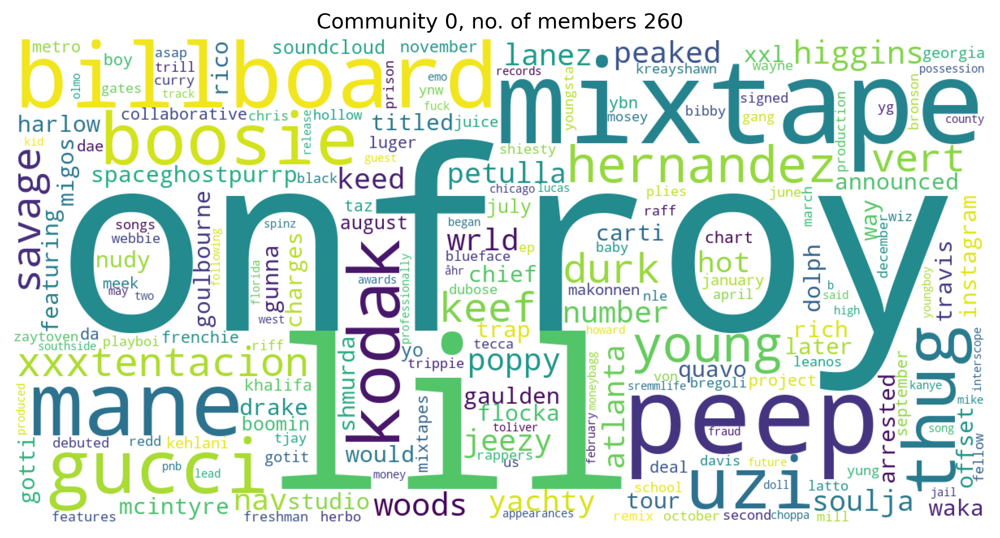

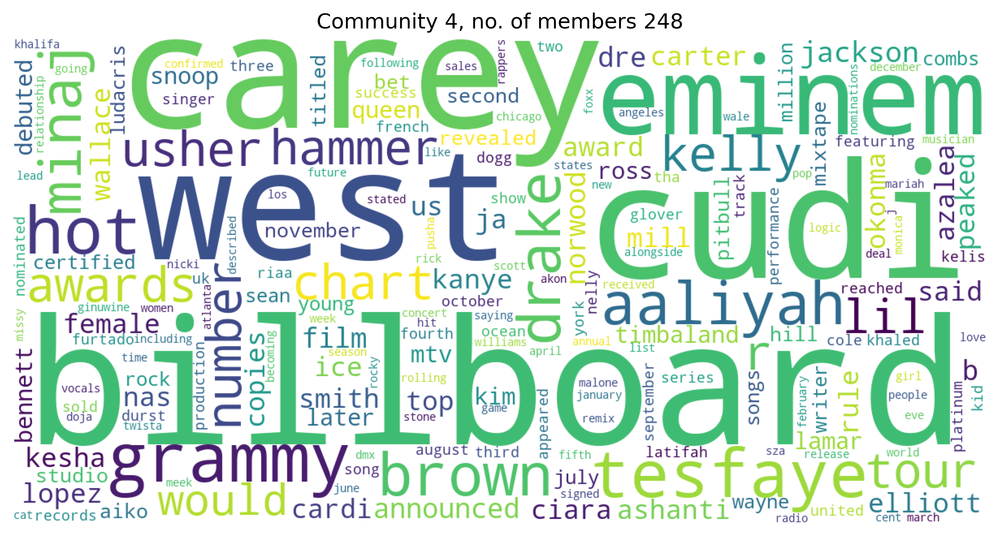

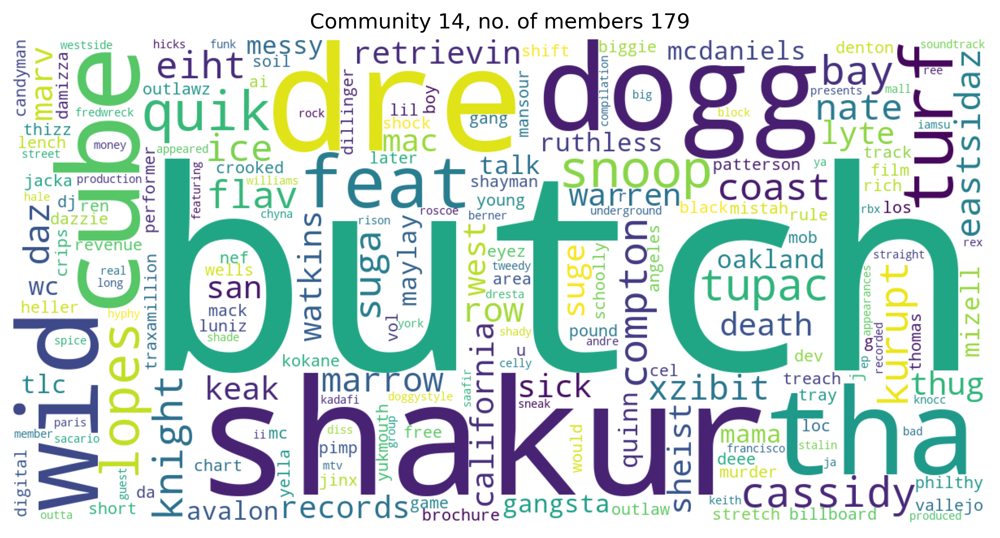

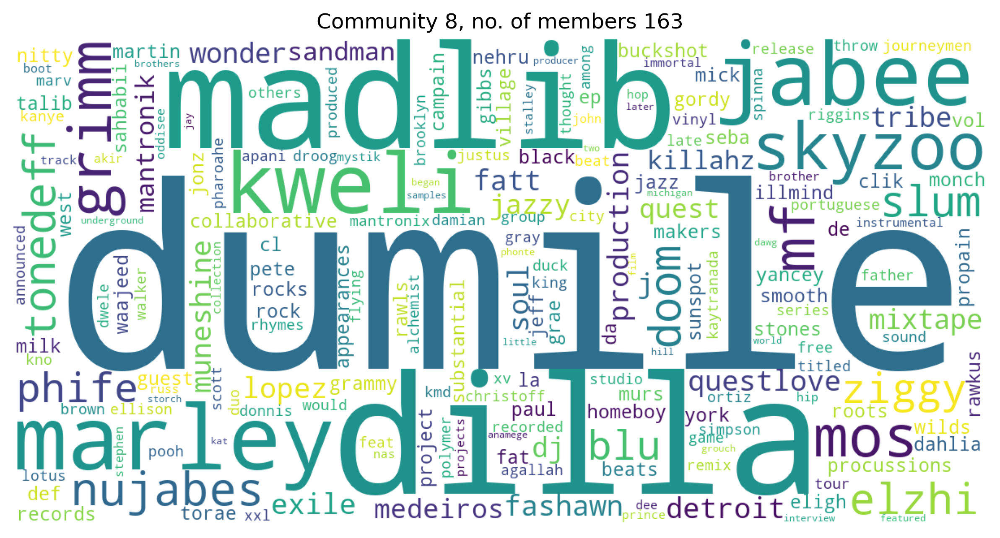

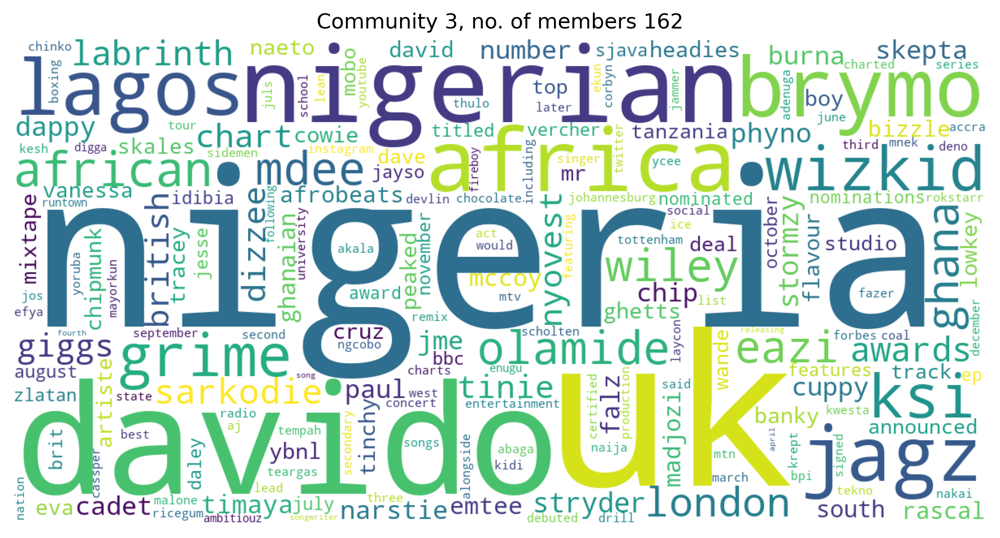

In [128]:
limit = True
for i, (key, text) in enumerate(tf_idf_louvain.items()):
    if i == 5 and limit: break
    if key == 'Other': continue
    fig, ax = plt.subplots(figsize=(10,10),dpi=300)
    w = WordCloud(background_color='white', width=1200, height=600)
    w.fit_words(tf_idf_louvain[key])      # fit the wordcloud based TF-IDF scores 
    ax.imshow(w.to_image())
    ax.axis('off')
    ax.set_title(f'Community {key}, no. of members {list(com_sizes.values())[i]}')
plt.savefig('wordclouds/louvain_community_wordcloud.png',dpi=300)

The figure above shows the top TF-IDF words for the largest communities in sorted order as identified by the community algorithm. We can for example see that for community 4 (the second largest community) that "The Weeknd" (Tesfaye is his last name) is very prominent, given the names are typically mentioned a lot on the Wikipedia pages we can also see that Drake, Cudi and Fergie must be in this community among others. Since we break the content of each artist's Wikipedia page into tokens, we also remove the link between first name and surname (or if their name is e.g. "The Weeknd"), and that is why we see names such as _West_, _Minaj_, Azalea_ etc. instead of _Kanye West_, _Nicki Minaj_ and _Iggy Azalea_.

Additionally, there are also a lot of words that are unknown to us. For example, if we look up "petulla" who is mentioned in community 0, we find that he is just mentioned a lot of times on his wikipedia which is probably what sends the words up so prominently.

We can see which community Drake is a member of

In [120]:
louvain_partition['Drake (musician)']

4

which also happens to be the second largest louvain partitioning.

<a id='discussion'></a>

# Discussion

<a id='outcome'></a>

### What went well
Generally, we think this project went well. We managed to perform network analysis on the artist links as well as looking at the sentiment scores for each of their respective Wikipedia pages. (*Communities*) Even though the 14 subgenres provided by us did not yield the highest modularity, we still believe that they provided some extra insight into how the communities could be divided, especially in the context of the communities found by the Louvain algorithm. The Louvain algorithm found +60 communities, and we found that only two of our communities based on the secondary genre seemed to _align_ with the partition of the Louvain communities. However, our partitioning was not infeasible, as we still saw more famous artists being grouped.

Using the theory and methods from the course, we have managed to create a thorough analysis of the network and artist connections. We have utilised websites and datasets e.g. the labMT hedonometer for the sentiment analysis part. The sentiment analysis of the Wikipedia pages turned out to give us the results we were expecting, i.e. uninteresting data showing a neutral trend in happiness score. We were already aware that Wikipedia inherently is neutral, which the analysis indeed did prove. At least we showed that Wikipedia is neutral if nothing else. This also goes to show that the tools of sentiment analysis are not very useful for Wikipedia content.

Though the sentiment analysis did not show much interesting behaviour, our word clouds in our text analysis yielded some quite informative characteristics of the respective artists. We were impressed by the words that surfaced for each of the artists, as they were based on the TF-IDF score they were good at showing specific words characterising the artists. In our opinion, they reflected the main things about the artists really well. With regards to the word clouds generated from the communities we also saw that they often had the artist names in their word clouds, which is due to the fact that the artist names are almost exclusive to their own Louvain partition, thereby making the TF-IDF score of the proper nouns greater.

Furthermore, since we have access to a more interactive experience in the form of a website, we wanted to try to create some interactive visualisations through plotly. The figures turned out great and we hope that they provide some extra quality to the presentation of the project. They did, however, also require a lot more effort from us, and some of the plots were infeasible to plot with plotly i.e. why we chose to embed some of the plots as PNG images.

<a id='future'></a>

### Future work

* What is still missing?

Initially, we had an idea to use many different music genres instead of just hip-hop as Wikipedia has an overview of all the genre subpages instead we ended up using just the hip-hop genre and using the sub-genre. Ideally, what we had wanted was to use the music genre as the top partition and see if we for instance would have found the communities to be similar to the music genres. However, it proved infeasible for us to gather the data as the different genre pages on Wikipedia all are formatted slightly different.

* What could be improved, and why?

Everything involving the age of the hip-hoppers could still be improved since some (very few) of the ages currently are parsed incorrectly. Crafting the regular expressions to find exactly what is wanted and nothing more is really meticulous, and we did not manage to perfect it. Maybe our approach to designing the expressions was flawed. 

Furthermore, we also found that the sentiment score did not show anything different from our expectations about it being neutral. To actually see a difference in sentiment score, and to conclude a difference between the Wikipedia pages would need further studies including more data and a more general dataset. Doing so would, however, be an entire project in itself.